#**`DCSI 592 Capstone II`**<br>
`Tumornators`<br>
  -Joseph Novak<br>
  -Shawn Oyer<br>
  -Patrick Obrien<br>
  -Thu Tran<br>
`Week 4:
 EDA`

##**`Setup`**

In [1]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [2]:
%%capture
!pip install pyfeats

In [3]:
nbdir = "/content/drive/MyDrive/DSCI 592 Group/"
%cd /content/drive/MyDrive/DSCI\ 592\ Group/

/content/drive/.shortcut-targets-by-id/1BhYZe1XofBTGFx4baMx5R_lUbTcscQK4/DSCI 592 Group


Import libraries

In [62]:
import os
import pandas as pd
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from skimage import filters
from skimage import data
from skimage import exposure
from skimage.segmentation import slic,clear_border
from skimage.color import label2rgb, rgb2gray
from skimage.feature import graycomatrix, graycoprops
from skimage.morphology import remove_small_objects,remove_small_holes, binary_closing,binary_dilation,disk, binary_erosion
from skimage.filters import roberts
from skimage.measure import label,regionprops

from scipy import ndimage as ndi
from scipy.ndimage import interpolation as inter
from scipy.stats import zscore

from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from keras.utils import plot_model
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score
import pickle
import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import cv2
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.utils import class_weight
from sklearn.metrics import classification_report, confusion_matrix
import joblib
from google.colab import files

import pyfeats
import glob
from sklearn.pipeline import make_pipeline
from sklearn import preprocessing
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
import matplotlib.patches as mpatches


**Custom functions**

In [5]:
# This code constructs all of our custom functions for image processing, segmentation, metadata, etc

# Creates a new Data Frame with image filepaths, labels, and metadata info for all images within the specified directories
def get_image_metadata(image_path):
    with Image.open(image_path) as img:
        # Extract metadata
        info = {
            "jfif": img.info['jfif'],
            "jfif_version": img.info['jfif_version'],
            "jfif_unit": img.info['jfif_unit'],
            "jfif_density": img.info['jfif_density']
        }
        metadata = {
            "width": img.width,
            "height": img.height
            #"exif": img.getexif()
        }
    return info, metadata

def extract_metadata(benign_dir, Malignant_dir, Normal_dir):
    filepaths = []
    labels = []
    class_labels = ['Benign', 'Malignant', 'Normal']

    dir_lists = [benign_dir, Malignant_dir, Normal_dir]

    for i, dir_list in enumerate(dir_lists):
        for j in dir_list:
            flist = os.listdir(j)
            for f in flist:
                fpath = os.path.join(j, f)
                filepaths.append(fpath)
                labels.append(class_labels[i])

    Fseries = pd.Series(filepaths, name="filepaths")
    Lseries = pd.Series(labels, name="labels")
    Lung_data = pd.concat([Fseries, Lseries], axis=1)
    Lung_df = pd.DataFrame(Lung_data)
    pd.set_option('display.max_colwidth', None)
    jfif = []
    jfif_version = []
    dpi = []
    jfif_unit = []
    jfif_density = []
    width=[]
    height=[]
    #exif=[]

    for i in Lung_df["filepaths"]:
        info, metadata = get_image_metadata(i)
        jfif.append(info['jfif'])
        jfif_version.append(info['jfif_version'])
        jfif_unit.append(info['jfif_unit'])
        jfif_density.append(info['jfif_density'])
        width.append(metadata['width'])
        height.append(metadata['height'])
        #exif.append(metadata['exif'])

    jfif_series = pd.Series(jfif, name="info")
    jfif_version_series = pd.Series(jfif_version, name="jfif_version")
    jfif_unit_series = pd.Series(jfif_unit, name="jfif_unit")
    jfif_density_series = pd.Series(jfif_density, name="jfif_density")
    width_series = pd.Series(width, name="width")
    height_series = pd.Series(height, name="height")
    #exif_series = pd.Series(exif, name="exif")

    Lung_df = pd.concat([Lung_df, jfif_series, jfif_version_series, jfif_unit_series, jfif_density_series, width_series, height_series], axis=1)

    return Lung_df


# Function to compute statistics for a single image
def compute_image_stats(image):

    image_array = np.array(image[np.nonzero(image)])

    stats = {
        #'Image ID': os.path.basename(image),
        'Mean Pixel Value': np.mean(image_array),
        'Std Dev Pixel Value': np.std(image_array),
        'Min Pixel Value': np.min(image_array),
        'Max Pixel Value': np.max(image_array),
        '25th Percentile': np.percentile(image_array, 25),
        '50th Percentile (Median)': np.percentile(image_array, 50),
        '75th Percentile': np.percentile(image_array, 75)
    }
    return stats

# Get all image paths
def get_image_paths(dirs, file_extension):
    image_paths = []
    for dir in dirs:
        image_paths.extend(glob.glob(os.path.join(dir, f'*.{file_extension}')))
    return image_paths

def display_stats(df, label):
    # Display the statistics in table format
    print(f"{label} Image Statistics")
    stats_table = df.describe().T  # Transpose for better readability
    print(stats_table)

    # Convert the table to LaTeX
    latex_table = stats_table.to_latex()
    print("\nLaTeX Table:")
    print(latex_table)

    # Plot the statistics
    stats_table[['mean', 'std', 'min', '25%', '50%', '75%', 'max']].plot(kind='bar', figsize=(10, 6))
    plt.title(f"{label} Image Statistics")
    plt.ylabel("Pixel Value")
    plt.xticks(rotation=45)
    plt.show()

def determine_score(arr, angle):
    data = inter.rotate(arr, angle, reshape=False, order=0)
    histogram = np.sum(data, axis=1, dtype=float)
    score = np.sum((histogram[1:] - histogram[:-1]) ** 2, dtype=float)
    return histogram, score

def correct_skew(image, delta=1, limit=5):
    #gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    thresh = cv.threshold(image, 0, 255, cv.THRESH_BINARY_INV + cv.THRESH_OTSU)[1]
    scores = []
    angles = np.arange(-limit, limit + delta, delta)
    for angle in angles:
        histogram, score = determine_score(thresh, angle)
        scores.append(score)
    best_angle = angles[scores.index(max(scores))]
    (h, w) = image.shape[:2]
    center = (w // 2, h // 2)
    M = cv.getRotationMatrix2D(center, best_angle, 1.0)
    corrected = cv.warpAffine(image, M, (w, h), flags=cv.INTER_CUBIC, \
            borderMode=cv.BORDER_REPLICATE)

    return best_angle, corrected

def bit_plane_slice(image):
    bit_planes = []
    for i in range(8):
        mask = 2 ** i
        bit_plane = np.bitwise_and(image, mask)
        bit_planes.append(bit_plane)

    return bit_planes

def reconstruct_image(bit_planes):
    reconstructed_image = np.zeros_like(bit_planes[0])
    for i in range(6):
        reconstructed_image = np.bitwise_or(reconstructed_image, bit_planes[-i])
    return reconstructed_image

def isolate_lung_area(image):
    label_image = label(image)
    regions = regionprops(label_image)
    filtered_regions = [region for region in regions if region.area >= 600]
    regions = sorted(filtered_regions, key=lambda x: x.area, reverse=True)

    if len(regions) > 3:
      top_n_regions = sorted(regions, key=lambda x: x.centroid[0])
      top_n_highest_regions = top_n_regions[:-2]
    elif len(regions) > 2:
      top_n_regions = sorted(regions, key=lambda x: x.centroid[0])
      top_n_highest_regions = top_n_regions[:-1]
    else:
      top_n_highest_regions = regions

    mask = np.zeros_like(label_image, dtype=bool)
    for region in top_n_highest_regions:
        for coordinates in region.coords:
          mask[coordinates[0], coordinates[1]] = 1
    return mask

# Function to predict class label for validation data
def predict_image(img):
    img_flat = img.flatten().reshape(1, -1)  # Flatten and reshape image to match the input format expected by the model
    # Load the trained RandomForestClassifier model
    #best_model = joblib.load('best_RF_model.pkl')
    # Predict class label for the image
    pred_label = best_model.predict(img_flat)[0]  # Assuming you're only interested in the prediction for the first image in the batch
    # Return the predicted label
    return pred_label


In [6]:
#Set Directories
benign_dir = ['./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases']
Malignant_dir = ['./data/The IQ-OTHNCCD lung cancer dataset/Malignant cases']
Normal_dir = ['./data/The IQ-OTHNCCD lung cancer dataset/Normal cases']

##**`Data generation and EDA`**##

In [7]:
# This code chunk takes ~5 mins
# Creates a new Data Frame with image filepaths, labels, and metadata info for all images within the specified directories
Lung_df = extract_metadata(benign_dir, Malignant_dir, Normal_dir)
Lung_df.head()

,filepaths,labels,info,jfif_version,jfif_unit,jfif_density,width,height
0,./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (96).jpg,Benign,257,"(1, 1)",1,"(120, 120)",512,512
1,./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (97).jpg,Benign,257,"(1, 1)",1,"(120, 120)",512,512
2,./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (87).jpg,Benign,257,"(1, 1)",1,"(120, 120)",512,512
3,./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (79).jpg,Benign,257,"(1, 1)",1,"(120, 120)",512,512
4,./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (99).jpg,Benign,257,"(1, 1)",1,"(120, 120)",512,512


**Data cleaning**

In [8]:
# Check for duplicates and NULL Values
# Drop duplicates
Lung_df = Lung_df.drop_duplicates()
print(Lung_df.shape)

# Check for NULL Values
print("\n Check for any null values in dataset:")
Lung_df = Lung_df.replace(r'^\s*$', np.nan, regex=True)
print(pd.isnull(Lung_df).sum())
print("\n Removing null values in dataset:")
print(pd.isnull(Lung_df).sum())

(1102, 8)

 Check for any null values in dataset:
filepaths       0
labels          0
info            0
jfif_version    0
jfif_unit       0
jfif_density    0
width           0
height          0
dtype: int64

 Removing null values in dataset:
filepaths       0
labels          0
info            0
jfif_version    0
jfif_unit       0
jfif_density    0
width           0
height          0
dtype: int64


In [9]:
# Print Value Counts to identify outliers or missing values
print(pd.value_counts(Lung_df["width"]))
print(pd.value_counts(Lung_df["height"]))
print(pd.value_counts(Lung_df["info"]))
print(pd.value_counts(Lung_df["jfif_version"]))
print(pd.value_counts(Lung_df["jfif_unit"]))
print(pd.value_counts(Lung_df["jfif_density"]))

width
512    1100
511       1
506       1
Name: count, dtype: int64
height
512    1100
404       1
331       1
Name: count, dtype: int64
info
257    1102
Name: count, dtype: int64
jfif_version
(1, 1)    1102
Name: count, dtype: int64
jfif_unit
1    1043
0      59
Name: count, dtype: int64
jfif_density
(120, 120)    1043
(1, 1)          59
Name: count, dtype: int64


Inclusion criteria: height x width = 512x512

In [43]:
#remove any rows with bad dimension
Lung_df_filtered = Lung_df[Lung_df["width"]==512]
Lung_df_filtered = Lung_df_filtered[Lung_df_filtered["height"]==512]
Lung_df_filtered.shape

(1100, 8)

**Class distribution**

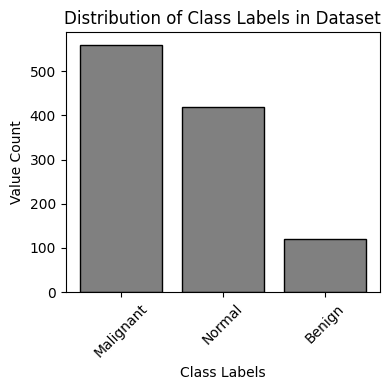

In [11]:
label_counts = Lung_df_filtered['labels'].value_counts()

plt.figure(figsize=(4, 4))
plt.bar(label_counts.index, label_counts.values, color='grey',edgecolor="black")
plt.xlabel('Class Labels')
plt.ylabel('Value Count')
plt.title('Distribution of Class Labels in Dataset')
plt.xticks(rotation=45)
plt.tight_layout()

#plt.savefig('label_barplot.jpg')
#files.download('label_barplot.jpg')

**Raw images first look**

<Figure size 640x480 with 0 Axes>

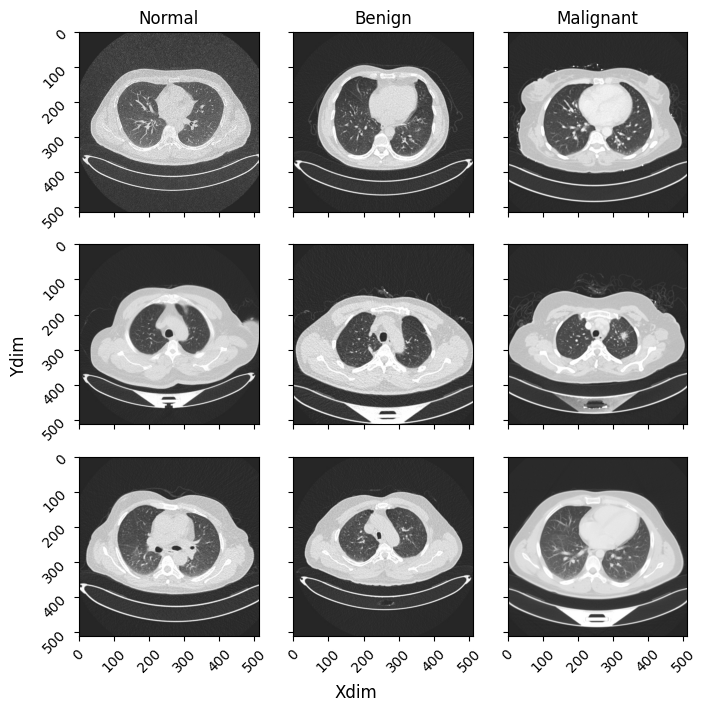

In [12]:
#View three of each image type
n1 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (319).jpg')
n2 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (123).jpg')
n3 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (243).jpg')
b1 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (11).jpg')
b2 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (119).jpg')
b3 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Bengin cases/Bengin case (70).jpg')
m1 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Malignant cases/Malignant case (118).jpg')
m2 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Malignant cases/Malignant case (129).jpg')
m3 = cv.imread('./data/The IQ-OTHNCCD lung cancer dataset/Malignant cases/Malignant case (340).jpg')

plt.figure()
fig, axs = plt.subplots(3, 3, figsize=(7, 7), layout='constrained',
                        sharex=True, sharey=True)
plt.xticks(rotation=45)

axs[0,0].imshow(n1)
axs[0,0].set_title('Normal')
axs[0,1].imshow(b1)
axs[0,1].set_title('Benign')
axs[0,2].imshow(m1)
axs[0,2].set_title('Malignant')
axs[1,0].imshow(n2)
axs[1,1].imshow(b2)
axs[1,2].imshow(m2)
axs[2,0].imshow(n3)
axs[2,1].imshow(b3)
axs[2,2].imshow(m3)

fig.supxlabel('Xdim')
fig.supylabel('Ydim')
for ax in fig.axes:
    plt.sca(ax)
    plt.xticks([0,100,200,300,400,500],rotation=45)
    plt.yticks(rotation=45)

Example of processing one image through the segmentation / mask pipeline

In [13]:
original = n1
camera =  cv.cvtColor(original, cv.COLOR_BGR2GRAY)
angle,corrected = correct_skew(camera)
bit_planes = bit_plane_slice(corrected)
bit_plane_reconstructed = reconstruct_image(bit_planes)
gauss = cv.GaussianBlur(bit_plane_reconstructed, (5, 5), 5)
thresh_val = filters.threshold_otsu(gauss)
thresh = gauss<thresh_val
cleared = clear_border(thresh)
cleared2 = binary_dilation(cleared)
cleared3= remove_small_objects(cleared2,min_size=450)
cleared4 = remove_small_holes(cleared3,area_threshold=100)
selem = disk(1, dtype=bool)
cleared5 = binary_closing(cleared4,disk(3))
cleared8 = isolate_lung_area(cleared5)
cleared9 = binary_closing(cleared8,disk(12))
result1 = gauss.copy()
result1[cleared9 == 0] = 0
result1[cleared9 != 0] = gauss[cleared9 != 0]


<ipython-input-5-9f5a3bdcf656>:115: DeprecationWarning: Please use `rotate` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  data = inter.rotate(arr, angle, reshape=False, order=0)


<Figure size 640x480 with 0 Axes>

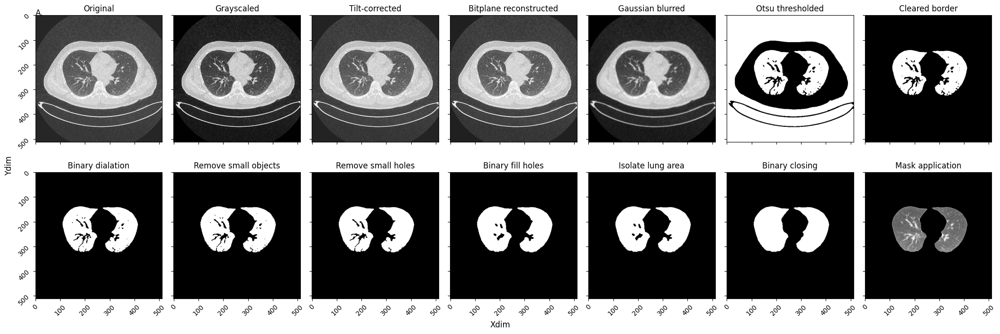

In [14]:
plt.figure()
fig, axs = plt.subplots(2, 7, figsize=(21, 7), layout='constrained',
                        sharex=True, sharey=True)
plt.xticks(rotation=45)

axs[0,0].imshow(original)
axs[0,0].set_title('Original')
axs[0,0].annotate('A.',(0,1),fontsize=12)

axs[0,1].imshow(camera,cmap="gray")
axs[0,1].set_title('Grayscaled')

axs[0,2].imshow(corrected,cmap="gray")
axs[0,2].set_title('Tilt-corrected')

axs[0,3].imshow(bit_plane_reconstructed,cmap="gray")
axs[0,3].set_title('Bitplane reconstructed')

axs[0,4].imshow(gauss,cmap="gray")
axs[0,4].set_title('Gaussian blurred')

axs[0,5].imshow(thresh,cmap="gray")
axs[0,5].set_title('Otsu thresholded')

axs[0,6].imshow(cleared,cmap="gray")
axs[0,6].set_title('Cleared border')

axs[1,0].imshow(cleared2,cmap="gray")
axs[1,0].set_title('Binary dialation')

axs[1,1].imshow(cleared3,cmap="gray")
axs[1,1].set_title('Remove small objects')

axs[1,2].imshow(cleared4,cmap="gray")
axs[1,2].set_title('Remove small holes')

axs[1,3].imshow(cleared5,cmap="gray")
axs[1,3].set_title('Binary fill holes')

axs[1,4].imshow(cleared8,cmap="gray")
axs[1,4].set_title('Isolate lung area')

axs[1,5].imshow(cleared9,cmap="gray")
axs[1,5].set_title('Binary closing')

axs[1,6].imshow(result1,cmap="gray")
axs[1,6].set_title('Mask application')

fig.supxlabel('Xdim')
fig.supylabel('Ydim')
for ax in fig.axes:
    plt.sca(ax)
    plt.xticks([0,100,200,300,400,500],rotation=45)
    plt.yticks(rotation=45)


#plt.savefig('one_image_process.jpg')
#files.download('one_image_process.jpg')

Define the image processing pipeline

In [15]:
def pipeline(image):
  v1 =  cv.cvtColor(image, cv.COLOR_BGR2GRAY)
  angle, v2 = correct_skew(v1)
  v3 = bit_plane_slice(v2)
  v4 = reconstruct_image(v3)
  v5 = cv.GaussianBlur(v4, (7, 7), 3)
  thresh_val = filters.threshold_otsu(v5)
  v6 = clear_border(v5<thresh_val)
  v7 = binary_dilation(v6)
  v8 = remove_small_objects(v7,min_size=450)
  v9 = remove_small_holes(v8,area_threshold=150)
  selem = disk(3, dtype=bool)
  v10 = binary_closing(v9,disk(3))
  v11 = ndi.binary_fill_holes(v10)
  v12 = binary_erosion(v11, selem)
  v13 = isolate_lung_area(v12)
  v14 = binary_closing(v13,disk(12))

  result1 = v5.copy()
  result1[v14 == 0] = 0
  result1[v14 != 0] = v5[v14 != 0]

  return result1

Apply pipeline to example data

<ipython-input-5-9f5a3bdcf656>:115: DeprecationWarning: Please use `rotate` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  data = inter.rotate(arr, angle, reshape=False, order=0)


<Figure size 640x480 with 0 Axes>

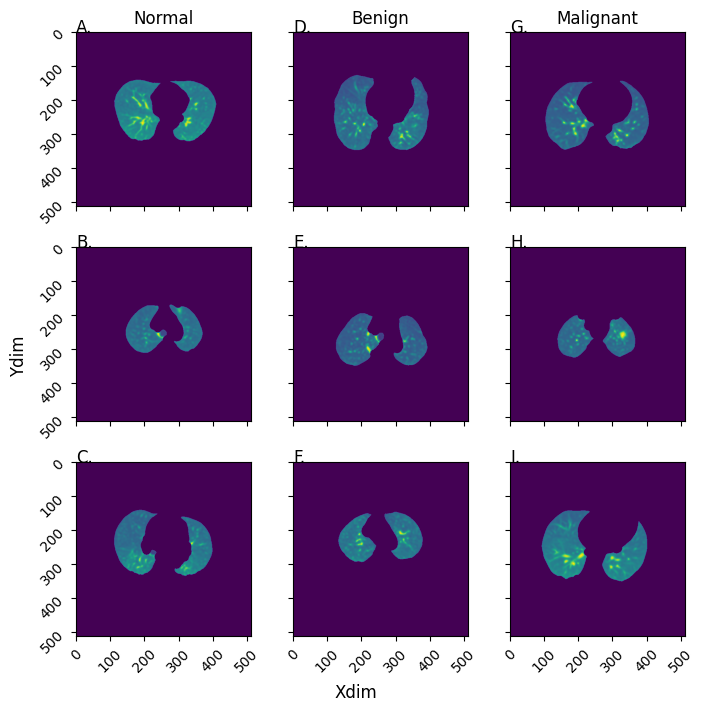

In [16]:
plt.figure()
fig, axs = plt.subplots(3, 3, figsize=(7, 7), layout='constrained',
                        sharex=True, sharey=True)
plt.xticks(rotation=45)

axs[0,0].imshow(pipeline(n1))
axs[0,0].set_title('Normal')
axs[0,0].annotate('A.',(0,1),fontsize=12)

axs[0,1].imshow(pipeline(b1))
axs[0,1].set_title('Benign')
axs[0,1].annotate('D.',(0,1),fontsize=12)

axs[0, 2].imshow(pipeline(m1))
axs[0, 2].set_title('Malignant')
axs[0, 2].annotate('G.', (0, 1), fontsize=12)

axs[1,0].imshow(pipeline(n2))
axs[1,0].annotate('B.',(0,1),fontsize=12)

axs[1,1].imshow(pipeline(b2))
axs[1,1].annotate('E.',(0,1),fontsize=12)

axs[1,2].imshow(pipeline(m2))
axs[1,2].annotate('H.',(0,1),fontsize=12)

axs[2,0].imshow(pipeline(n3))
axs[2,0].annotate('C.',(0,1),fontsize=12)

axs[2,1].imshow(pipeline(b3))
axs[2,1].annotate('F.',(0,1),fontsize=12)

axs[2,2].imshow(pipeline(m3))
axs[2,2].annotate('I.',(0,1),fontsize=12)

fig.supxlabel('Xdim')
fig.supylabel('Ydim')
for ax in fig.axes:
    plt.sca(ax)
    plt.xticks([0,100,200,300,400,500],rotation=45)
    plt.yticks(rotation=45)

**Scale to entire dataset**

Process all images through the segmentation / mask pipeline

In [17]:
#process images and add to image_array
#this chunk take ~7min
image_array=[]
for i in Lung_df_filtered["filepaths"]:
  image_array.append(pipeline(cv.imread(i)))

<ipython-input-5-9f5a3bdcf656>:115: DeprecationWarning: Please use `rotate` from the `scipy.ndimage` namespace, the `scipy.ndimage.interpolation` namespace is deprecated.
  data = inter.rotate(arr, angle, reshape=False, order=0)


Compute pixel statistics, ignoring 0's. Effectively, this  values measures only pixels from the segmented lung tissue

In [18]:
image_stats = [compute_image_stats(image_path) for image_path in image_array]
image_stats_df = pd.DataFrame(image_stats)

left-join statistics to the metadata table

In [54]:
Lung_df_filtered_2 = pd.concat([Lung_df_filtered.reset_index(drop=True), image_stats_df.reset_index(drop=True)],axis=1)
print(len(Lung_df_filtered_2))
Lung_df_filtered_2.tail()

1100


,filepaths,labels,info,jfif_version,jfif_unit,jfif_density,width,height,Mean Pixel Value,Std Dev Pixel Value,Min Pixel Value,Max Pixel Value,25th Percentile,50th Percentile (Median),75th Percentile
1095,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (100) (1).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.218981,16.174997,68,209,87.0,92.0,100.0
1096,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (100).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.218981,16.174997,68,209,87.0,92.0,100.0
1097,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (105).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,81.715537,19.061850,55,190,62.0,84.0,93.0
1098,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (109).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.196273,9.630153,79,166,90.0,94.0,100.0
1099,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (106).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,83.832403,20.059146,57,213,65.0,84.0,93.0


Plot per-class mean pixel intensity values

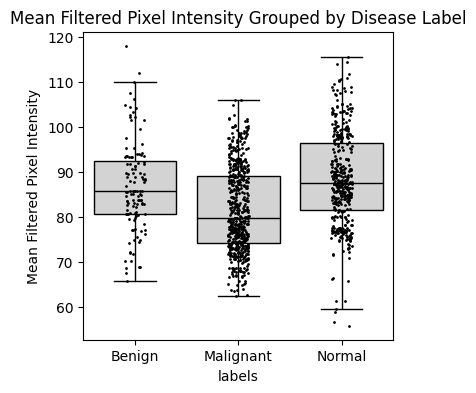

In [49]:
plt.figure(figsize=(4, 4))
sns.boxplot(x=Lung_df_filtered_2["labels"],y=Lung_df_filtered_2['Mean Pixel Value'],showfliers=False,color="#D3D3D3",linecolor="black")
sns.stripplot(x=Lung_df_filtered_2["labels"],y=Lung_df_filtered_2['Mean Pixel Value'],color='black', size=2)
plt.title('Mean Filtered Pixel Intensity Grouped by Disease Label')
plt.ylabel('Mean Filtered Pixel Intensity')
plt.show()

Compute the texture features to be used for machine learning

In [21]:
#compute feature arrays for GLCM texture analysis
data=[]
for img in image_array:
    glcm = pyfeats.glcm_features(img,ignore_zeros=True)[0]
    data.append(glcm)

labels = ["GLCM_ASM", "GLCM_Contrast", "GLCM_Correlation","GLCM_SumOfSquaresVariance", "GLCM_InverseDifferenceMoment","GLCM_SumAverage", "GLCM_SumVariance", "GLCM_SumEntropy","GLCM_Entropy", "GLCM_DifferenceVariance","GLCM_DifferenceEntropy", "GLCM_Information1","GLCM_Information2", "GLCM_MaximalCorrelationCoefficient"]

temp = pd.DataFrame(data,columns=labels)
temp.head()

,GLCM_ASM,GLCM_Contrast,GLCM_Correlation,GLCM_SumOfSquaresVariance,GLCM_InverseDifferenceMoment,GLCM_SumAverage,GLCM_SumVariance,GLCM_SumEntropy,GLCM_Entropy,GLCM_DifferenceVariance,GLCM_DifferenceEntropy,GLCM_Information1,GLCM_Information2,GLCM_MaximalCorrelationCoefficient
0,0.003151,17.413711,0.959636,215.609563,0.357386,186.708436,845.024542,6.584985,9.230138,0.000868,3.060233,-0.353117,0.989354,3.838743
1,0.003151,17.413711,0.959636,215.609563,0.357386,186.708436,845.024542,6.584985,9.230138,0.000868,3.060233,-0.353117,0.989354,3.838743
2,0.002678,25.371919,0.978964,603.037047,0.367040,161.770973,2386.776268,7.080501,9.763228,0.000716,3.183501,-0.397681,0.995676,4.284616
3,0.004435,16.145839,0.943772,143.530992,0.376801,169.108465,557.978128,6.221664,8.750897,0.000987,2.974762,-0.331225,0.982864,3.633882
4,0.003573,20.594139,0.963055,278.646442,0.369259,182.811616,1093.991629,6.563422,9.149501,0.000777,3.069156,-0.360546,0.990093,3.848954


In [55]:
#Concatenate feature attributes with metadata table
master_table = pd.concat([Lung_df_filtered_2.reset_index(drop=True), temp.reset_index(drop=True)], axis=1)
print(len(master_table))
master_table.tail()
#Lung_df.to_csv("metadata_w_features.csv")
#from google.colab import files
#files.download("metadata_w_features.csv")

1100


,filepaths,labels,info,jfif_version,jfif_unit,jfif_density,width,height,Mean Pixel Value,Std Dev Pixel Value,...,GLCM_InverseDifferenceMoment,GLCM_SumAverage,GLCM_SumVariance,GLCM_SumEntropy,GLCM_Entropy,GLCM_DifferenceVariance,GLCM_DifferenceEntropy,GLCM_Information1,GLCM_Information2,GLCM_MaximalCorrelationCoefficient
1095,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (100) (1).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.218981,16.174997,...,0.333711,192.460615,1031.891664,6.590960,9.364349,0.000693,3.227687,-0.330711,0.986459,4.051681
1096,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (100).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.218981,16.174997,...,0.333711,192.460615,1031.891664,6.590960,9.364349,0.000693,3.227687,-0.330711,0.986459,4.051681
1097,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (105).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,81.715537,19.061850,...,0.468910,163.417390,1441.407291,6.393060,8.528402,0.001096,2.755163,-0.430977,0.994960,3.788395
1098,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (109).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,96.196273,9.630153,...,0.352137,192.312764,360.224424,5.978339,8.565632,0.000990,2.933967,-0.291204,0.969840,3.426291
1099,./data/The IQ-OTHNCCD lung cancer dataset/Normal cases/Normal case (106).jpg,Normal,257,"(1, 1)",1,"(120, 120)",512,512,83.832403,20.059146,...,0.438501,167.659780,1590.243304,6.610694,8.887552,0.000920,2.854950,-0.425945,0.995546,3.994074


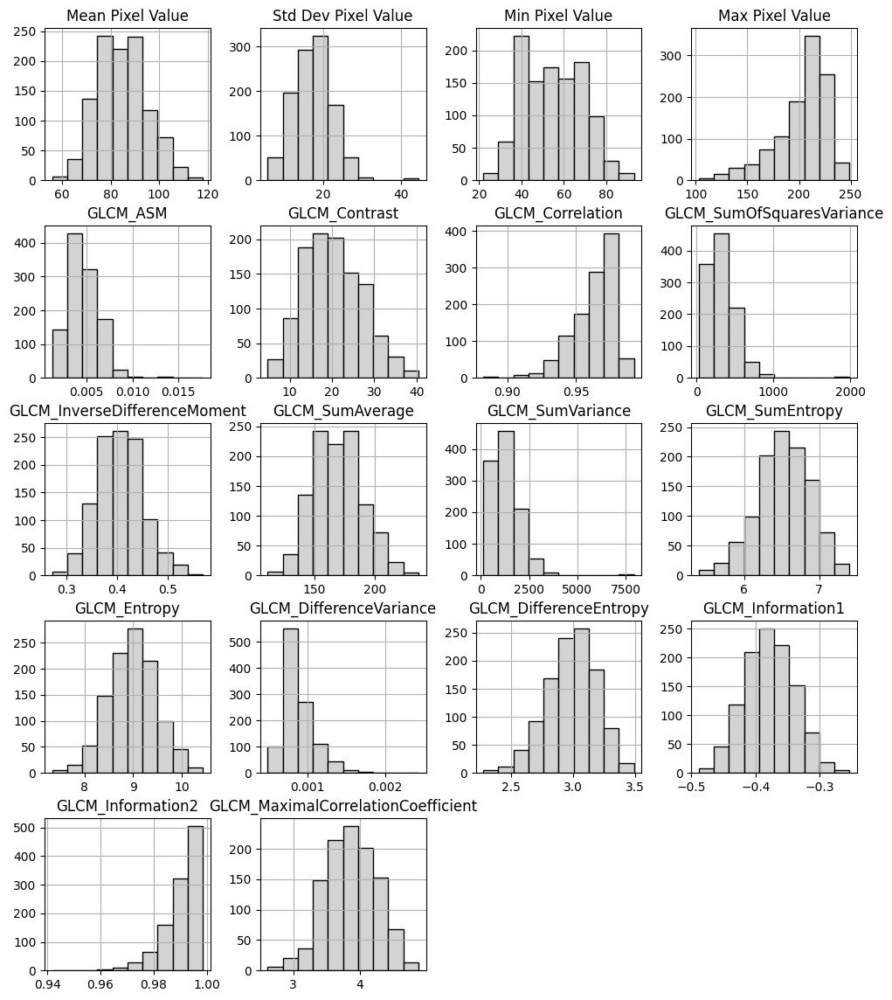

In [57]:
master_table.drop(['filepaths', 'labels', 'info', 'jfif_version', 'jfif_unit',
       'jfif_density','width', 'height',"25th Percentile","50th Percentile (Median)","75th Percentile"],axis=1).hist(bins=10, figsize=(12,14),edgecolor="black",color="#D3D3D3")
plt.show()

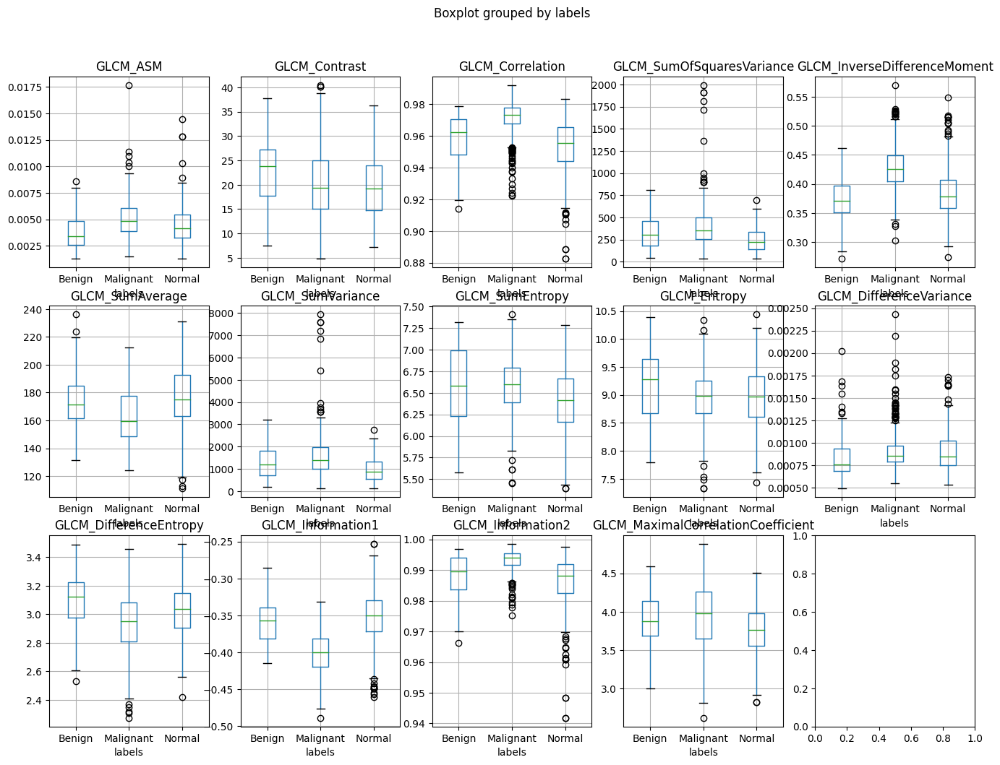

In [58]:
fig, ax = plt.subplots(3, 5, figsize=(16, 12))
master_table.boxplot('GLCM_ASM','labels', ax=ax[0, 0])
master_table.boxplot('GLCM_Contrast','labels', ax=ax[0, 1])
master_table.boxplot('GLCM_Correlation','labels', ax=ax[0,2])
master_table.boxplot('GLCM_SumOfSquaresVariance','labels', ax=ax[0,3])
master_table.boxplot('GLCM_InverseDifferenceMoment','labels', ax=ax[0,4])
master_table.boxplot('GLCM_SumAverage','labels', ax=ax[1, 0])
master_table.boxplot('GLCM_SumVariance','labels', ax=ax[1, 1])
master_table.boxplot('GLCM_SumEntropy','labels', ax=ax[1,2])
master_table.boxplot('GLCM_Entropy','labels', ax=ax[1,3])
master_table.boxplot('GLCM_DifferenceVariance','labels', ax=ax[1,4])
master_table.boxplot('GLCM_DifferenceEntropy','labels', ax=ax[2, 0])
master_table.boxplot('GLCM_Information1','labels', ax=ax[2, 1])
master_table.boxplot('GLCM_Information2','labels', ax=ax[2,2])
master_table.boxplot('GLCM_MaximalCorrelationCoefficient','labels', ax=ax[2,3])
plt.show()

Correlate the image texture features are any redundant / complementory?

<Axes: >

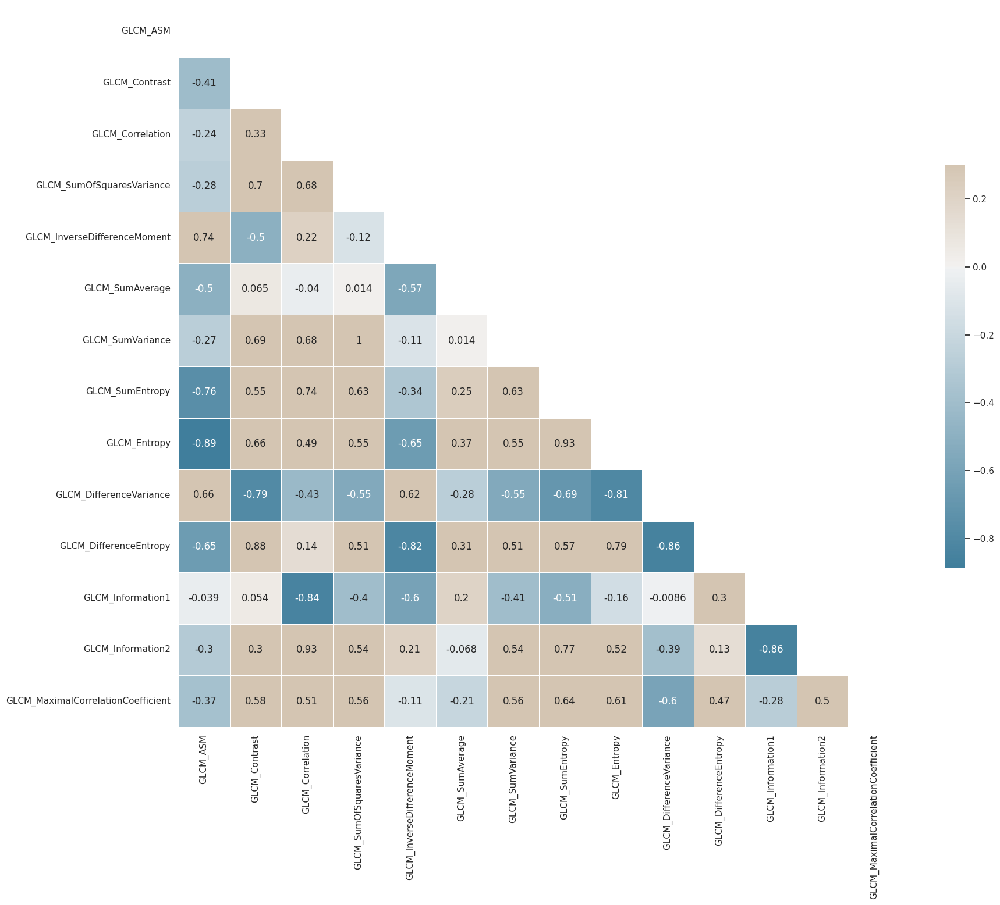

In [67]:
master_table_new_drop = master_table.drop(columns=["Mean Pixel Value","Std Dev Pixel Value","25th Percentile","50th Percentile (Median)","75th Percentile",'filepaths', 'labels', 'info', 'jfif_version',
                                                               'jfif_unit', 'jfif_density', 'width', 'height','Max Pixel Value', 'Min Pixel Value'])
sns.set(style="white")
corr = master_table_new_drop.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(20, 18))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 50, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

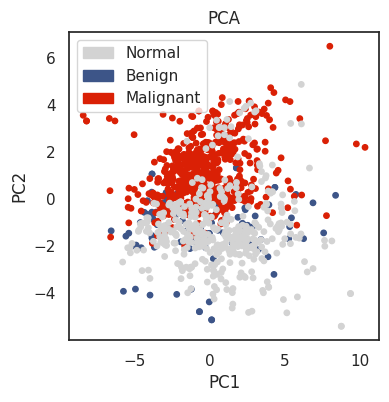

In [68]:
colors = {'Normal':'#D3D3D3', 'Benign':'#3D5588', 'Malignant':'#DA2005'}
PCA_obj=PCA(n_components=2)

df=temp
df=df.apply(zscore)
#print(df.head())

PCA_obj.fit(df)
x=PCA_obj.transform(df)[:,0]
y=PCA_obj.transform(df)[:,1]
plt.figure(figsize=[4,4])
plot = plt.scatter(x,y,c=Lung_df_filtered_2["labels"].map(colors),s=15)
plt.title("PCA")
plt.xlabel('PC1')
plt.ylabel('PC2')

#define the legend
red_patch = mpatches.Patch(color='#DA2005', label='Malignant')
blue_patch = mpatches.Patch(color='#3D5588', label='Benign')
grey_patch = mpatches.Patch(color='#D3D3D3', label='Normal')

plt.legend(handles=[grey_patch,blue_patch, red_patch])

#plt.savefig('PCA.jpg')
#files.download('PCA.jpg')

##ML Models

**Logistic Regression**

Split dataset into train/test

In [ ]:
X_1 = temp
Y_1 = Lung_df_filtered["labels"]

X_1_train, X_1_test, Y_1_train, Y_1_test = train_test_split(X_1, Y_1,test_size=.3,stratify = Y_1, random_state = 70000)

Define logistic regression pipeline

In [ ]:
numeric_features = X_1_train.columns
numeric_transformer = Pipeline(
    steps=[
        ('scaler',preprocessing.StandardScaler())
    ]
)

preprocessor_all = ColumnTransformer(
    transformers=[
        ('num',numeric_transformer,numeric_features)
    ]
)

L1 = Pipeline(
    steps=[('preprocessor',preprocessor_all),('classifier',LogisticRegression(multi_class='multinomial',penalty='l1',solver="saga",C=1))]
)

In [ ]:
parameters = [{'C': [.01, .1, 1, 10, 100, 1000]}]
lasso_grid = Pipeline(
    steps=[('preprocessor', preprocessor_all),
           ('classifier', GridSearchCV(estimator=LogisticRegression(multi_class='multinomial', penalty='l1', solver="saga",max_iter=10000,tol=.001),
                                      param_grid=parameters))])

<Axes: >

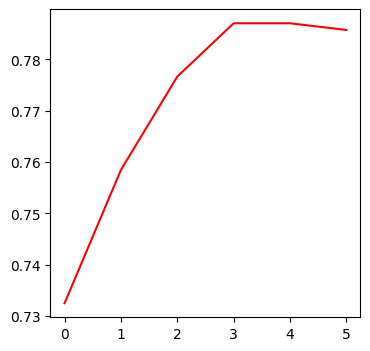

In [ ]:
lasso_grid.fit(X_1_train, Y_1_train)
plt.figure(figsize=[4,4])
sns.lineplot(lasso_grid.named_steps['classifier'].cv_results_['mean_test_score'],color='red')


In [ ]:
L1.fit(X_1_train,Y_1_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scaler',
                                                                   StandardScaler())]),
                                                  Index(['GLCM_ASM', 'GLCM_Contrast', 'GLCM_Correlation',
       'GLCM_SumOfSquaresVariance', 'GLCM_InverseDifferenceMoment',
       'GLCM_SumAverage', 'GLCM_SumVariance', 'GLCM_SumEntropy',
       'GLCM_Entropy', 'GLCM_DifferenceVariance', 'GLCM_DifferenceEntropy',
       'GLCM_Information1', 'GLCM_Information2',
       'GLCM_MaximalCorrelationCoefficient'],
      dtype='object'))])),
                ('classifier',
                 LogisticRegression(C=1, multi_class='multinomial',
                                    penalty='l1', solver='saga'))])

Classification Report:
              precision    recall  f1-score   support

      Benign       0.00      0.00      0.00        36
   Malignant       0.83      0.94      0.88       168
      Normal       0.70      0.75      0.73       126

    accuracy                           0.77       330
   macro avg       0.51      0.56      0.54       330
weighted avg       0.69      0.77      0.73       330

Accuracy of the Model: 76.7%


([<matplotlib.axis.YTick at 0x7ae252f17ac0>,
 [Text(0, 0, 'Benign'), Text(0, 1, 'Malignant'), Text(0, 2, 'Normal')])

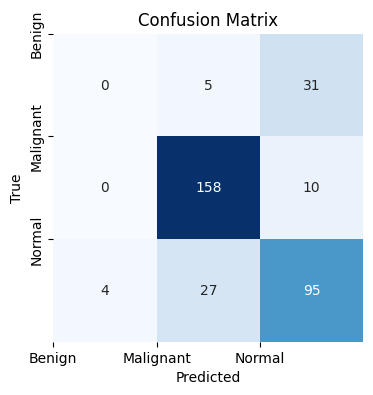

In [ ]:
# Output Classification report on Testing Data and Confusion Matrix
# Generate classification report
print("Classification Report:")
print(classification_report(Y_1_test, L1.predict(X_1_test)))
# Define class labels
class_labels = ["Benign", "Malignant", "Normal"]
# Generate confusion matrix
conf_matrix = confusion_matrix(Y_1_test, L1.predict(X_1_test))
# Print accuracy
print("Accuracy of the Model: {:.1f}%".format(accuracy_score(Y_1_test, L1.predict(X_1_test)) * 100))
# Plot confusion matrix
plt.figure(figsize=(4, 4))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap="Blues", cbar=False)
plt.title("Confusion Matrix")
plt.xlabel("Predicted")
plt.ylabel("True")
plt.xticks(ticks=np.arange(len(class_labels)), labels=class_labels)
plt.yticks(ticks=np.arange(len(class_labels)), labels=class_labels)
#plt.savefig('confusion.jpg')
#files.download('confusion.jpg')

In [ ]:
print('model score: %.3f' % L1.score(X_1_test,Y_1_test))

model score: 0.767


In [ ]:
L1.steps[1][1].coef_

array([[ 0.29506039,  0.        ,  0.        ,  0.        , -0.34234328,
        -0.08013076,  0.        ,  0.05030892,  0.21026571,  0.        ,
         0.        ,  0.        , -0.0136687 ,  0.        ],
       [-0.58900589, -1.1092231 ,  0.67770833,  0.41430293,  1.77039978,
         0.        ,  0.44478553, -0.16711971, -1.58524842,  0.23359984,
         1.99173287,  0.        ,  1.47594324,  0.        ],
       [ 0.        ,  0.70818837,  0.        , -0.46881734, -0.04987188,
         0.77395942, -0.49608985,  0.        ,  0.00214698, -0.23032545,
        -1.14564644,  0.        , -0.06677239,  0.39223393]])

**Convolutional Neural Network (CNN)**

In [ ]:
pip install tensorflow

In [ ]:
# Split the data into X and y for input into the model and print the shapes of the train, test, and validation data.

# Function to load images from filepaths
def load_images(filepaths):
    images = []
    for filepath in filepaths:
        # Load image using OpenCV
        img = cv.imread(filepath)
        if img is None:
            print(f"Error: Unable to read image at {filepath}")
            continue
        # Resize image to a consistent size
        img = cv.resize(img, (224, 224))
        # Normalize pixel values
        img = img / 255.0  # Normalize pixel values to [0, 1]
        # Flatten image
        img_flat = img.flatten()
        images.append(img_flat)
    return np.array(images)

# Split data into features and labels
X = Lung_df["filepaths"]
y = Lung_df["labels"]

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Split the training set further into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.25, random_state=42)

# Load images for training, validation, and testing sets
X_train_images = load_images(X_train)
X_val_images = load_images(X_val)
X_test_images = load_images(X_test)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)
print(X_val.shape)
print(y_val.shape)

(660,)
(221,)
(660,)
(221,)
(221,)
(221,)


In [ ]:
# Create the Image Data Generator that creates a pipeline for the CNN

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import precision_score, recall_score, f1_score

image_gen = ImageDataGenerator(preprocessing_function=tf.keras.applications.mobilenet_v2.preprocess_input)

train = image_gen.flow_from_dataframe(dataframe=pd.DataFrame({'filepaths': X_train, 'labels': y_train}),
                                      x_col="filepaths", y_col="labels",
                                      target_size=(224, 224),
                                      color_mode='rgb',
                                      class_mode="categorical",
                                      batch_size=4,
                                      shuffle=False)

test = image_gen.flow_from_dataframe(dataframe=pd.DataFrame({'filepaths': X_test, 'labels': y_test}),
                                     x_col="filepaths", y_col="labels",
                                     target_size=(224, 224),
                                     color_mode='rgb',
                                     class_mode="categorical",
                                     batch_size=4,
                                     shuffle=False)

val = image_gen.flow_from_dataframe(dataframe=pd.DataFrame({'filepaths': X_val, 'labels': y_val}),
                                    x_col="filepaths", y_col="labels",
                                    target_size=(224, 224),
                                    color_mode='rgb',
                                    class_mode="categorical",
                                    batch_size=4,
                                    shuffle=False)

Found 660 validated image filenames belonging to 3 classes.
Found 221 validated image filenames belonging to 3 classes.
Found 221 validated image filenames belonging to 3 classes.


In [ ]:
# Set up CNN Model Sequential with all necessary parameters, compile the model and output the model summary.
# Used the keras by tensorflow CNN model base but added multiple Batch Normalizations as a custom setting

import tensorflow as tf
from tensorflow.keras import layers, models

model = models.Sequential([
    layers.Conv2D(filters=128, kernel_size=(8, 8), strides=(3, 3), activation='relu', input_shape=(224, 224, 3)),
    layers.BatchNormalization(),

    layers.Conv2D(filters=256, kernel_size=(5, 5), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPooling2D(pool_size=(3, 3)),

    layers.Conv2D(filters=256, kernel_size=(3, 3), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.Conv2D(filters=256, kernel_size=(1, 1), strides=(1, 1), activation='relu', padding="same"),
    layers.BatchNormalization(),

    layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),
    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),

    layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),

    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Conv2D(filters=512, kernel_size=(3, 3), activation='relu', padding="same"),
    layers.BatchNormalization(),

    layers.MaxPooling2D(pool_size=(2, 2)),

    layers.Flatten(),
    layers.Dense(1024, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(1024, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(3, activation='softmax')
])

model.compile(
    loss='categorical_crossentropy',
    optimizer=tf.optimizers.SGD(learning_rate=0.001),
    metrics=['accuracy']
)

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 73, 73, 128)       24704     
                                                                 
 batch_normalization (Batch  (None, 73, 73, 128)       512       
 Normalization)                                                  
                                                                 
 conv2d_1 (Conv2D)           (None, 73, 73, 256)       819456    
                                                                 
 batch_normalization_1 (Bat  (None, 73, 73, 256)       1024      
 chNormalization)                                                
                                                                 
 max_pooling2d (MaxPooling2  (None, 24, 24, 256)       0         
 D)                                                              
                                                        

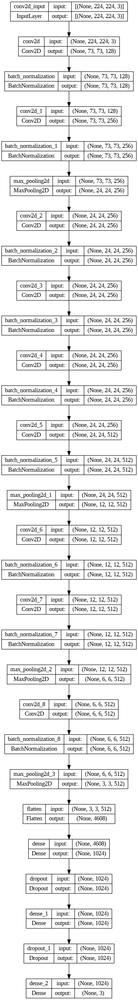

In [ ]:
# Output the CNN Model Workflow and save as an image

from keras.utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# Train the model and save the model architecture, weights, training history, evaluate the model, predict probabilities for test data and calculate metrics

import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import precision_score, recall_score, f1_score
import pickle

# Train your model and save the training history
history = model.fit(train, epochs=10, validation_data=val, verbose=1)

# Save model architecture and weights
model.save("./ML_Models/Lung_CNN_model.h5")

# Save training history
with open("./ML_Models/history_Lung_CNN.pkl", "wb") as file:
    pickle.dump(history.history, file)

# Evaluate the model on test data
test_loss, test_accuracy = model.evaluate(test)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

# Predict probabilities for test data
y_pred_prob = model.predict(test)
y_pred = np.argmax(y_pred_prob, axis=1)
y_true = test.classes

# Calculate precision, recall, and F1 scores
precision = precision_score(y_true, y_pred, average='weighted')
recall = recall_score(y_true, y_pred, average='weighted')
f1 = f1_score(y_true, y_pred, average='weighted')

print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)

In [ ]:
# Load the model (so the code above doesnt have to be run each time)

from tensorflow.keras.models import load_model
model_path = './ML_Models/Lung_CNN_model.h5'
loaded_model = load_model(model_path)

In [ ]:
# Load the model history from the pickle file

import pickle

# Specify the path to the pickle file
pickle_file_path = './ML_Models/history_Lung_CNN.pkl'


# Load the history data from the pickle file
with open(pickle_file_path, 'rb') as file:
    history_data = pickle.load(file)

train_accuracy_history = history_data['accuracy']
val_accuracy_history = history_data['val_accuracy']
train_loss_history = history_data['loss']
val_loss_history = history_data['val_loss']

# Print the loaded data
print(train_accuracy_history)
print(val_accuracy_history)
print(train_loss_history)
print(val_loss_history)

[0.5378788113594055, 0.6848484873771667, 0.7575757503509521, 0.8242424130439758, 0.8560606241226196, 0.9060605764389038, 0.9363636374473572, 0.9484848380088806, 0.9575757384300232, 0.9742424488067627]
[0.438914030790329, 0.8009049892425537, 0.8687782883644104, 0.9276018142700195, 0.9547511339187622, 0.918552041053772, 0.9502262473106384, 0.9321267008781433, 0.9864253401756287, 0.9728506803512573]
[1.7802791595458984, 1.0591790676116943, 0.7445425987243652, 0.5007171630859375, 0.38922882080078125, 0.2924981713294983, 0.18057703971862793, 0.13189803063869476, 0.12959420680999756, 0.06983057409524918]
[0.9069644808769226, 0.5039346814155579, 0.40777483582496643, 0.2518627345561981, 0.1781310737133026, 0.21444815397262573, 0.15937504172325134, 0.13296151161193848, 0.09515485167503357, 0.0838959664106369]


In [ ]:
# Create predicted and actual labels

pred = loaded_model.predict(test)
pred = np.argmax(pred, axis=1) #pick class with highest  probability

labels = (train.class_indices)
labels = dict((v,k) for k,v in labels.items())
pred2 = [labels[k] for k in pred]

56/56 [==============================] - 4s 28ms/step


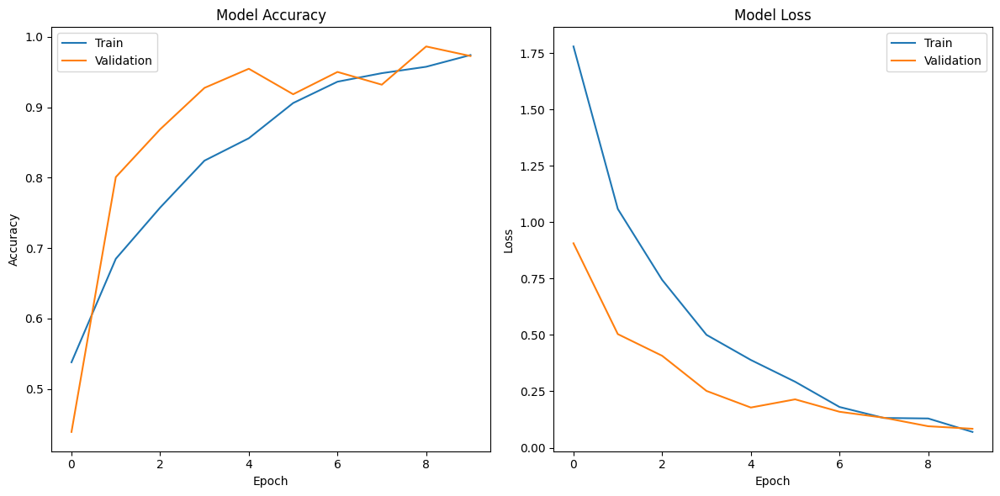

In [ ]:
# Plot Model Accuracy and Model Loss for Train and Validation

# Plot training & validation accuracy values
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(history_data['accuracy'])
plt.plot(history_data['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')

# Plot training & validation loss values
plt.subplot(1, 2, 2)
plt.plot(history_data['loss'])
plt.plot(history_data['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')

plt.tight_layout()
plt.show()

56/56 [==============================] - 2s 25ms/step - loss: 0.1095 - accuracy: 0.9367
Test Loss: 0.10951927304267883
Test Accuracy: 0.9366515874862671
              precision    recall  f1-score   support

      Benign       1.00      0.62      0.77        29
   Malignant       0.98      0.99      0.99       113
      Normal       0.87      0.97      0.92        79

    accuracy                           0.94       221
   macro avg       0.95      0.86      0.89       221
weighted avg       0.94      0.94      0.93       221

Accuracy of the Model: 93.7%


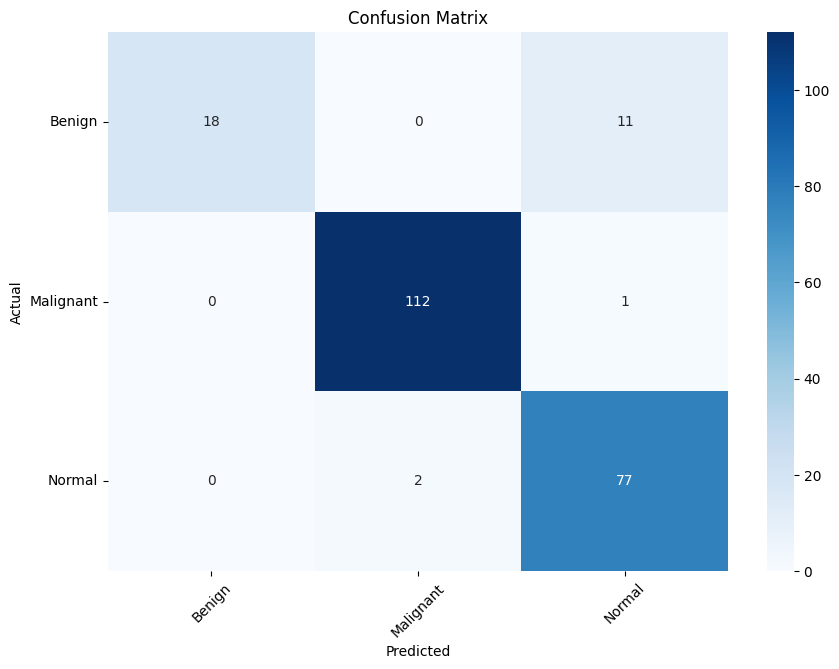

In [ ]:
# Determine the predicted classes for the test set, get true labels, load the model history, plot classification report and confusion matrix

import numpy as np
import pickle
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import matplotlib.pyplot as plt
import seaborn as sns

# Predict classes for the test data
pred = loaded_model.predict(test)
pred = np.argmax(pred, axis=1)  # Pick class with highest probability

# Map predicted class indices to class labels
labels = (train.class_indices)
labels = dict((v, k) for k, v in labels.items())
pred_labels = [labels[k] for k in pred]

# Get true labels from the test generator
true_labels = test.classes
true_labels = [labels[k] for k in true_labels]

# Load the model history
with open("./ML_Models/history_Lung_CNN.pkl", "rb") as file:
    history = pickle.load(file)

# Evaluate the model on test data
test_loss, test_accuracy = loaded_model.evaluate(test)
print("Test Loss:", test_loss)
print("Test Accuracy:", test_accuracy)

# Plot classification report
print(classification_report(true_labels, pred_labels, target_names=list(labels.values())))

# Print accuracy
print("Accuracy of the Model: {:.1f}%".format(accuracy_score(true_labels, pred_labels) * 100))

# Plot confusion matrix
class_labels = list(labels.values())

cm = confusion_matrix(true_labels, pred_labels, labels=class_labels)

plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='g', vmin=0, cmap='Blues')

plt.xticks(ticks=np.arange(len(class_labels)) + 0.5, labels=class_labels, rotation=45)
plt.yticks(ticks=np.arange(len(class_labels)) + 0.5, labels=class_labels, rotation=0)
plt.xlabel("Predicted")
plt.ylabel("Actual")

plt.title("Test Set Confusion Matrix")

plt.show()


56/56 [==============================] - 1s 25ms/step - loss: 0.0839 - accuracy: 0.9729
Validation Loss: 0.0838959664106369
Validation Accuracy: 0.9728506803512573
              precision    recall  f1-score   support

      Benign       1.00      0.73      0.85        15
   Malignant       0.98      1.00      0.99       114
      Normal       0.96      0.98      0.97        92

    accuracy                           0.97       221
   macro avg       0.98      0.90      0.94       221
weighted avg       0.97      0.97      0.97       221

Accuracy of the Model on Validation Set: 97.3%


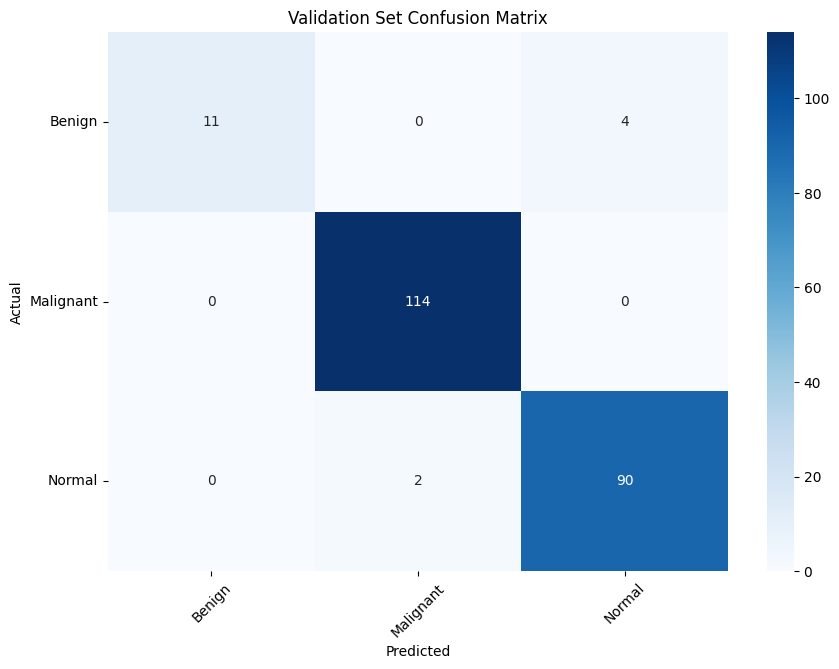

In [ ]:
# Determine the predicted classes for the validation set, get true labels, load the model history, plot classification report and confusion matrix

# Predict classes for the validation data
pred_val = loaded_model.predict(val)
pred_val = np.argmax(pred_val, axis=1)  # Pick class with highest probability

# Map predicted class indices to class labels
pred_labels_val = [labels[k] for k in pred_val]

# Get true labels from the validation generator
true_labels_val = val.classes
true_labels_val = [labels[k] for k in true_labels_val]

# Evaluate the model on validation data
val_loss, val_accuracy = loaded_model.evaluate(val)
print("Validation Loss:", val_loss)
print("Validation Accuracy:", val_accuracy)

# Plot classification report for validation set
print(classification_report(true_labels_val, pred_labels_val, target_names=list(labels.values())))

# Print accuracy
print("Accuracy of the Model on Validation Set: {:.1f}%".format(accuracy_score(true_labels_val, pred_labels_val) * 100))

# Plot confusion matrix for validation set
cm_val = confusion_matrix(true_labels_val, pred_labels_val, labels=class_labels)

plt.figure(figsize=(10, 7))
sns.heatmap(cm_val, annot=True, fmt='g', vmin=0, cmap='Blues')

plt.xticks(ticks=np.arange(len(class_labels)) + 0.5, labels=class_labels, rotation=45)
plt.yticks(ticks=np.arange(len(class_labels)) + 0.5, labels=class_labels, rotation=0)
plt.xlabel("Predicted")
plt.ylabel("Actual")

plt.title("Validation Set Confusion Matrix")

plt.show()

In [ ]:
# Create a function to determine predicted label vs actual label for each image

# Define the function to predict an image's label
def predict_image(image_data):
    # Reshape and preprocess image data as needed for prediction
    image_data = image_data.reshape((1, 224, 224, 3))  # Adjust the shape if necessary
    prediction = loaded_model.predict(image_data)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Assuming X_val_images is already loaded and preprocessed
for i, image_data in enumerate(X_val_images):
    pred_class_index = predict_image(image_data)
    pred_label = labels[pred_class_index]  # Convert class index to class label
    actual_label_index = val.classes[i]  # Get the actual class index from validation data generator
    actual_label = labels[actual_label_index]  # Convert class index to class label
    print(f"Predicted Label: {pred_label}, Actual Label: {actual_label}")

1/1 [==============================] - 0s 227ms/step
Predicted Label: Malignant, Actual Label: Malignant
1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Normal
1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Malignant
1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Malignant
1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Malignant
1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign
1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal
1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal
1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal
1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


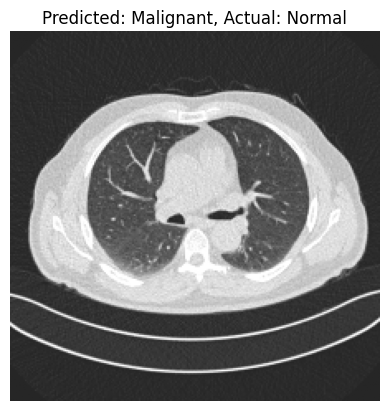

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


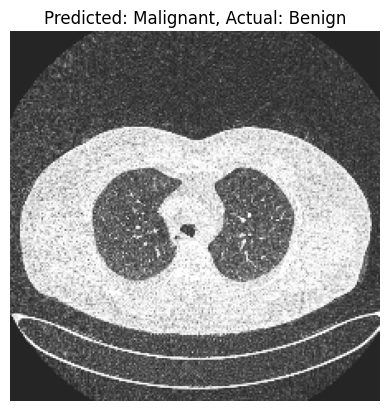

1/1 [==============================] - 0s 34ms/step
Predicted Label: Malignant, Actual Label: Normal


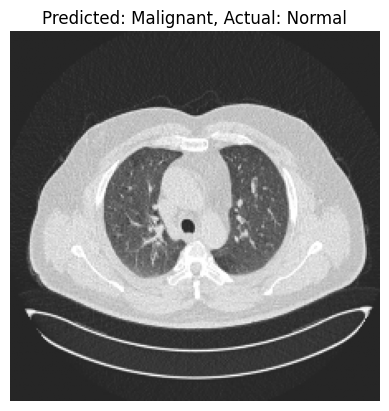

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


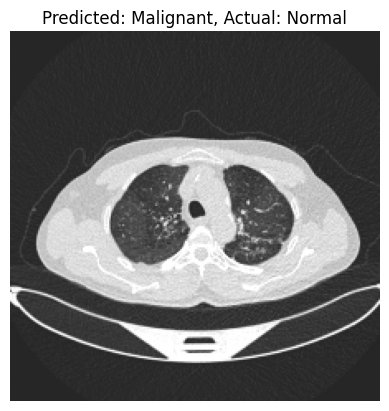

1/1 [==============================] - 0s 30ms/step
Predicted Label: Malignant, Actual Label: Normal


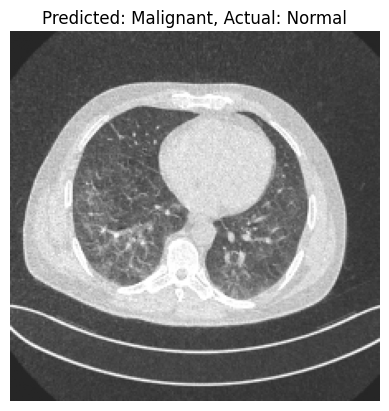

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


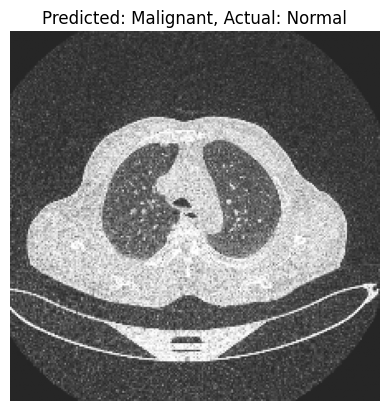

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


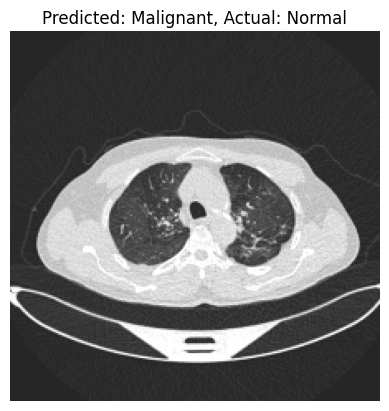

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


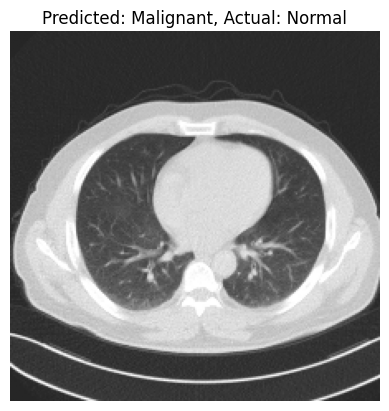

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


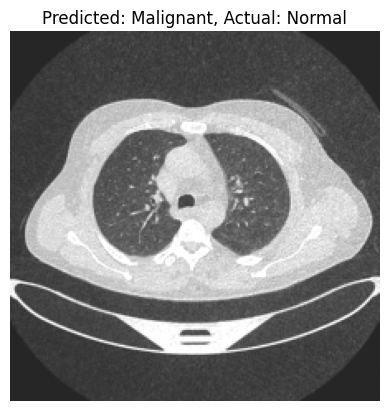

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


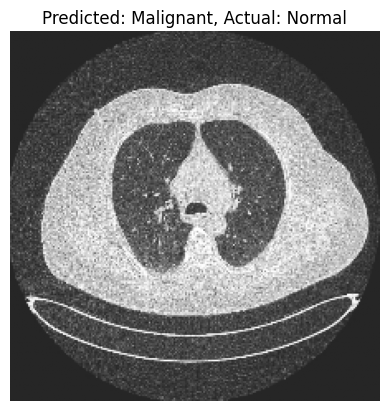

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


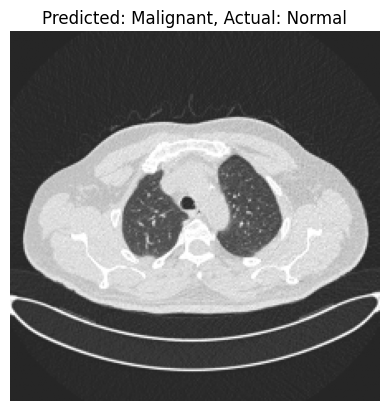

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


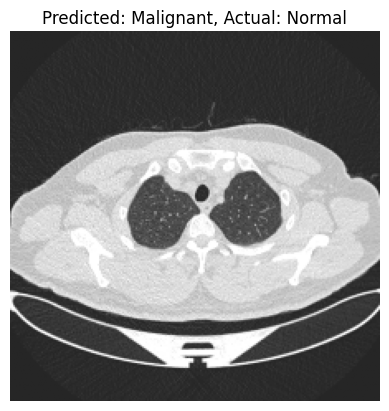

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


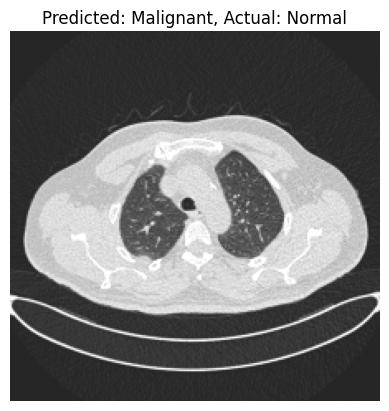

1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Benign


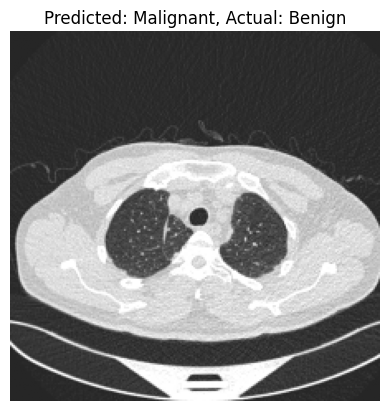

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


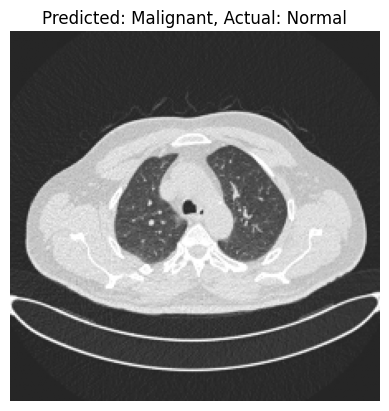

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


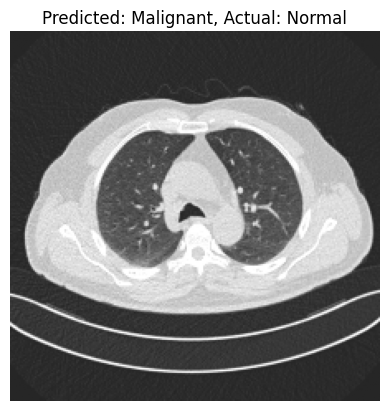

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


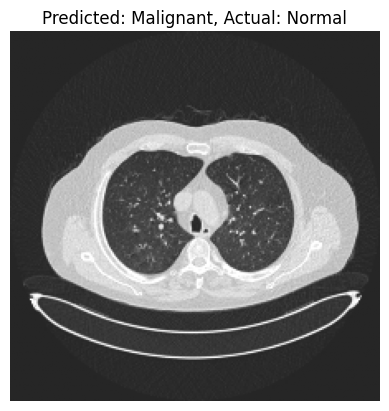

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


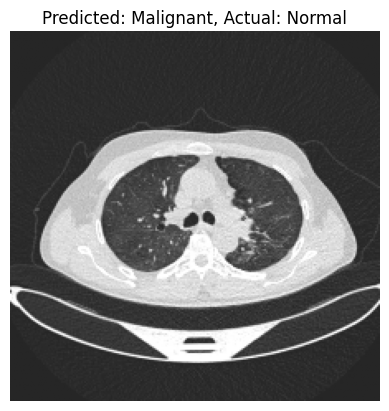

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


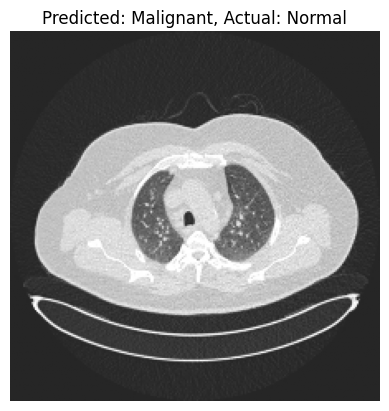

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


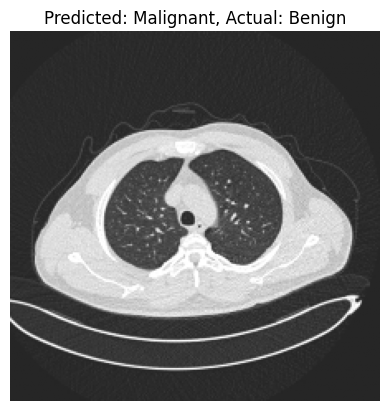

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


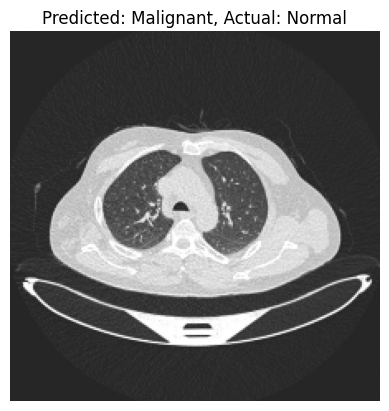

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


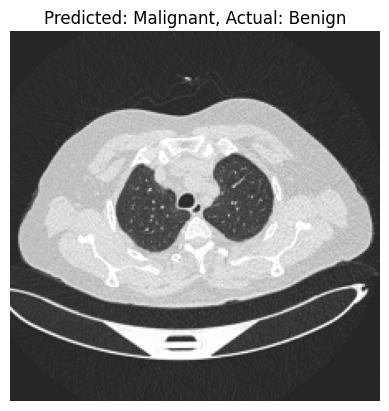

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


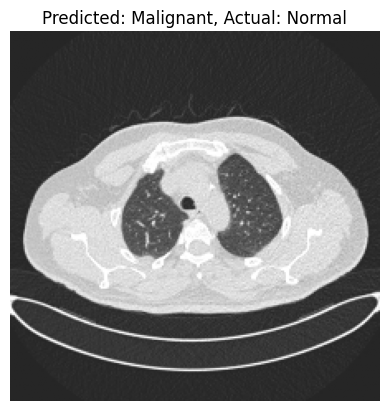

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


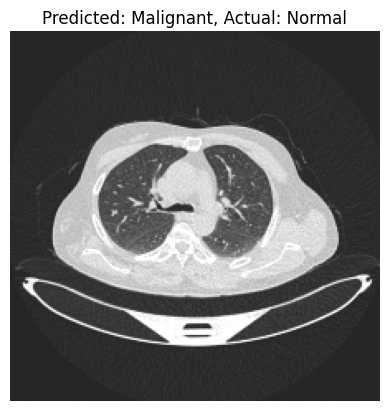

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


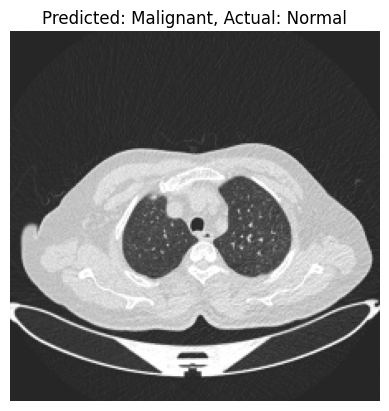

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


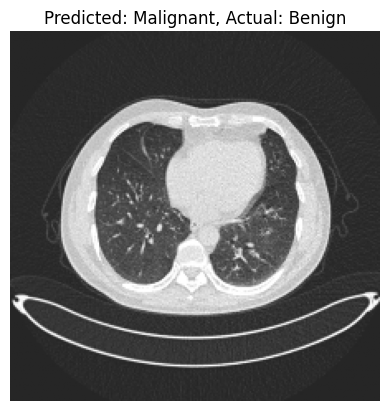

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


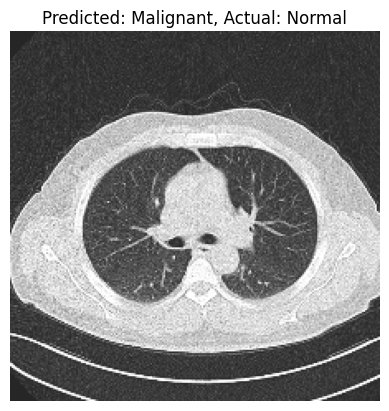

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


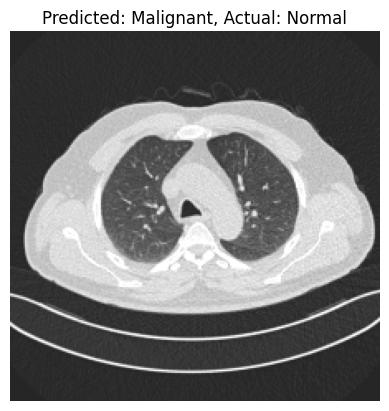

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


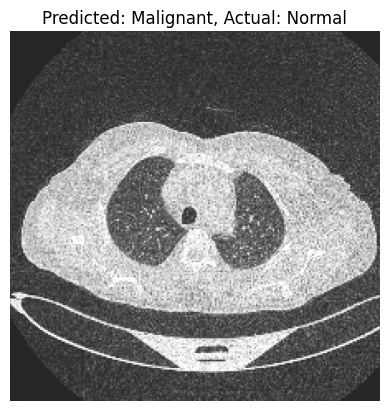

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


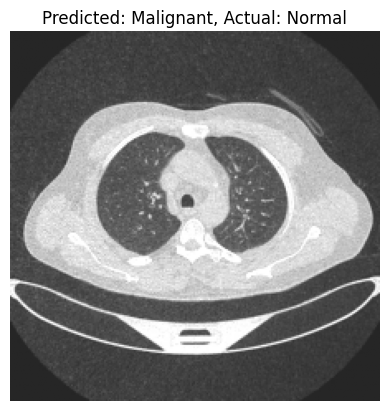

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


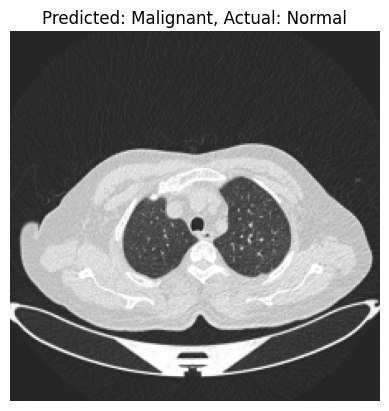

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


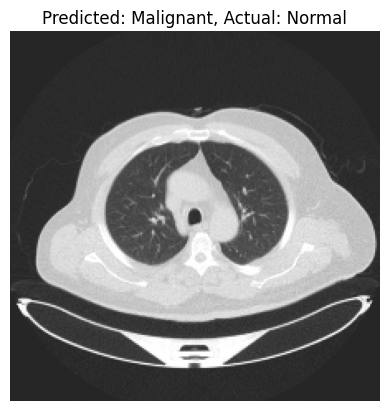

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


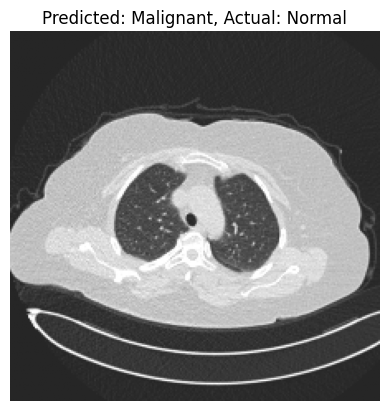

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


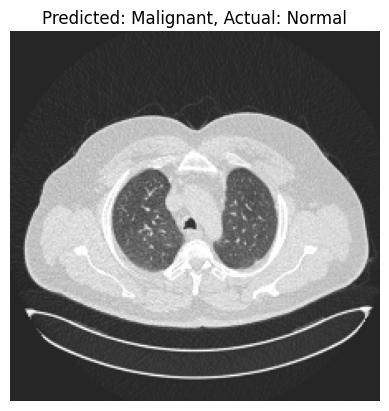

1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Normal


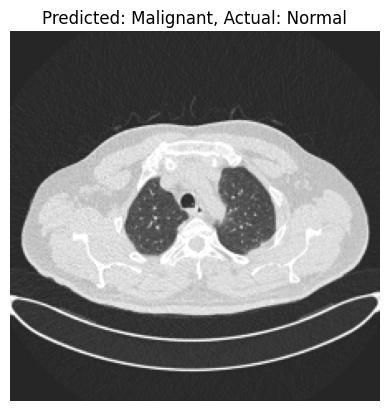

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


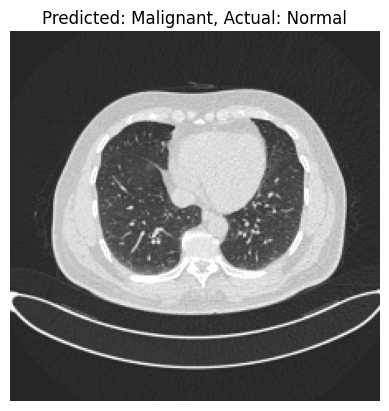

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


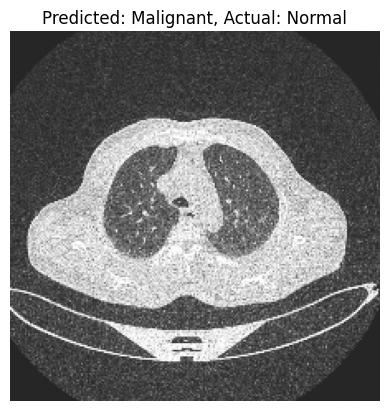

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


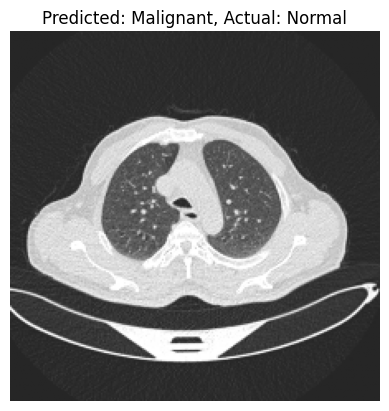

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


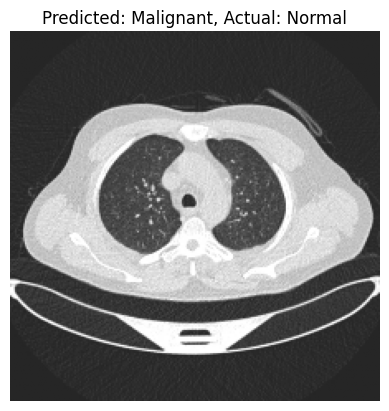

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


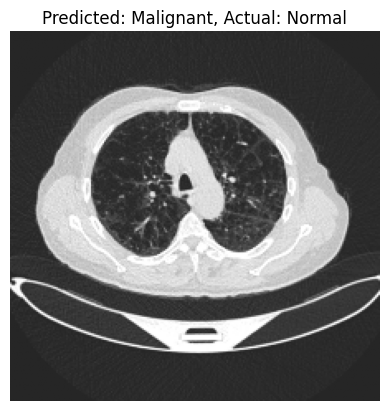

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


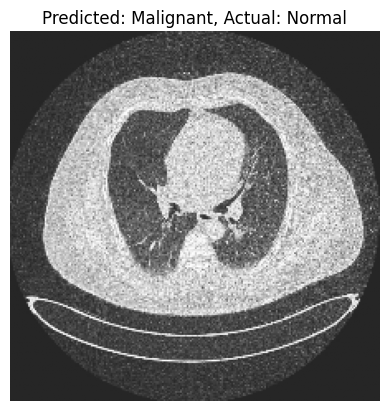

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


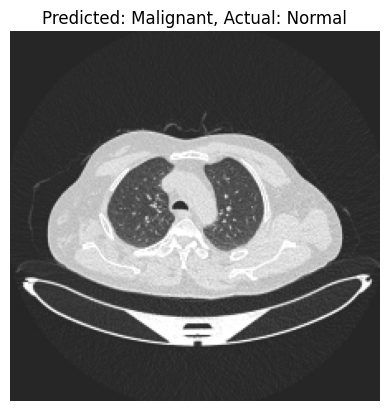

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


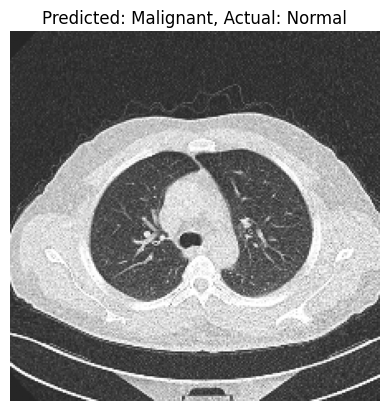

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


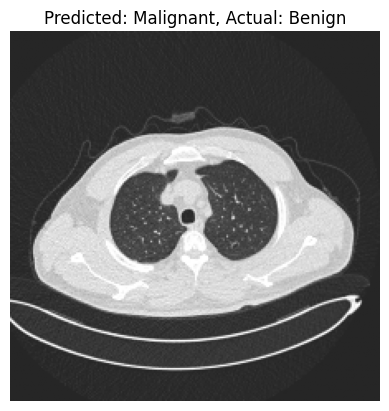

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


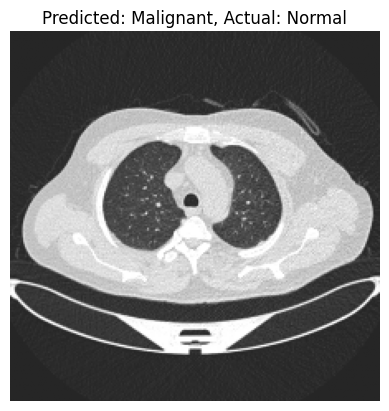

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


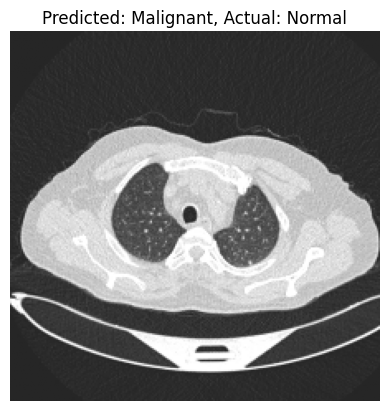

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


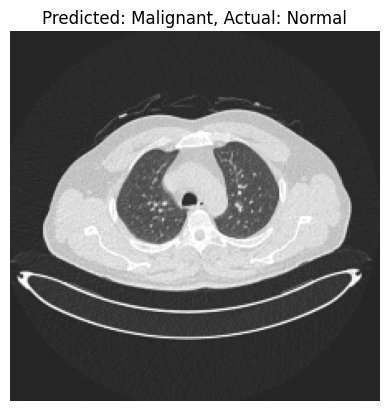

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


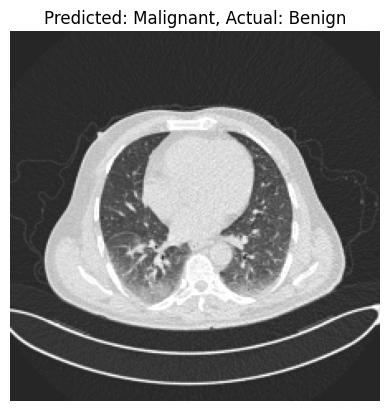

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


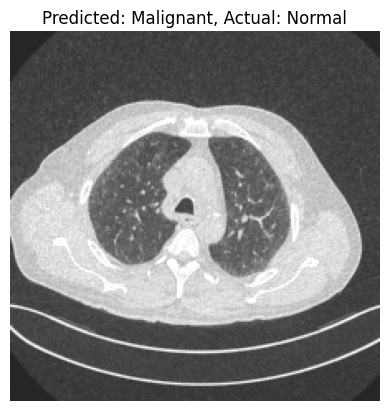

1/1 [==============================] - 0s 32ms/step
Predicted Label: Malignant, Actual Label: Normal


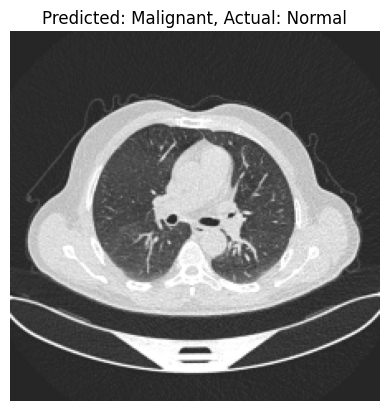

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


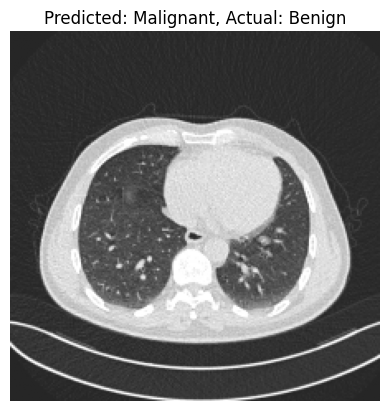

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


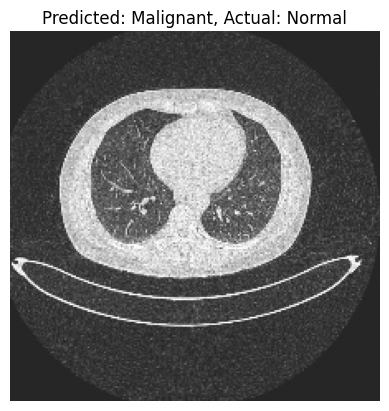

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


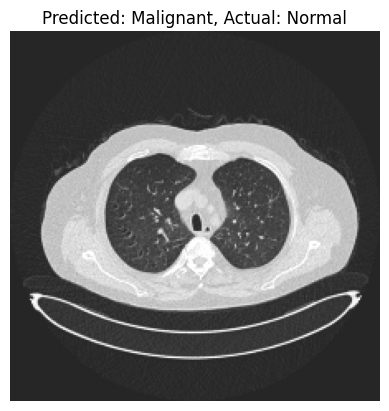

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


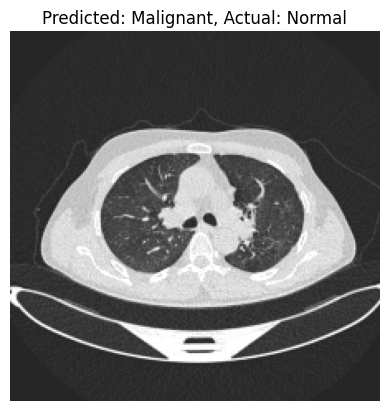

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


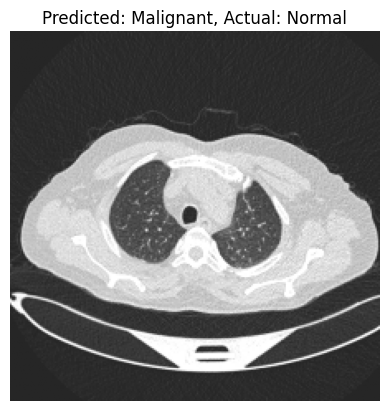

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


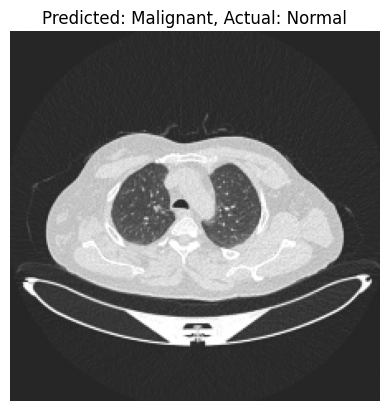

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


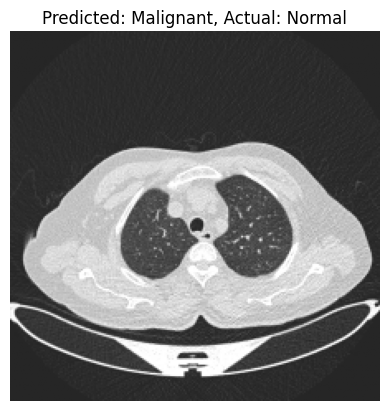

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


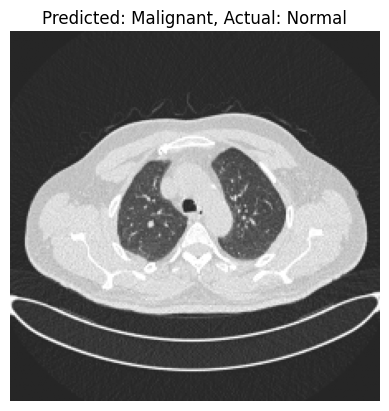

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


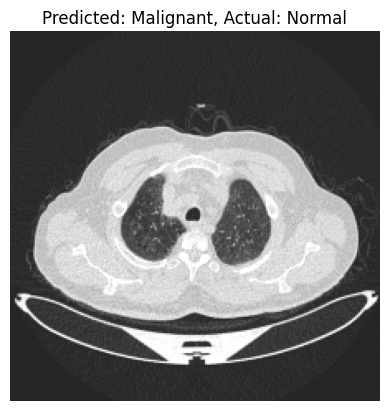

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


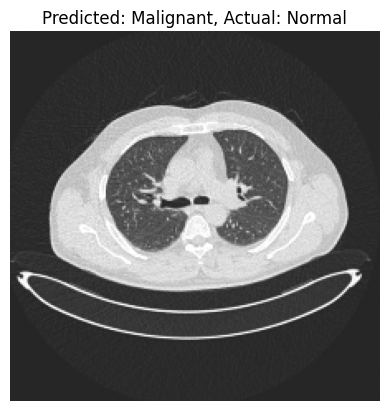

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


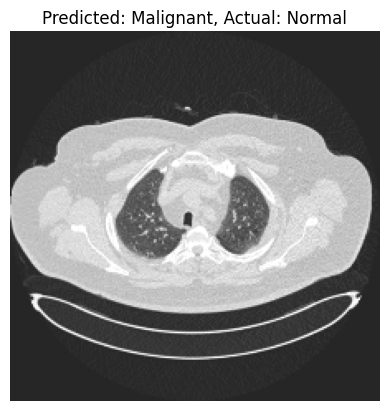

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


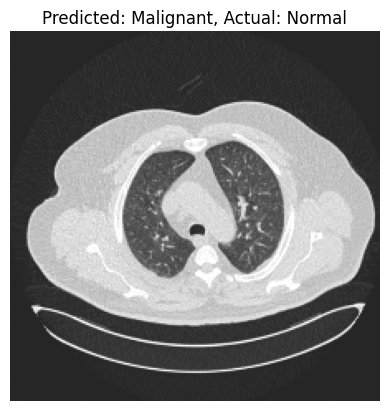

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


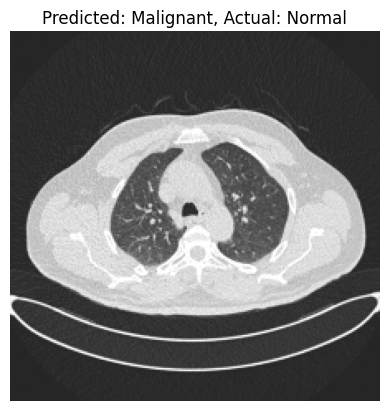

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


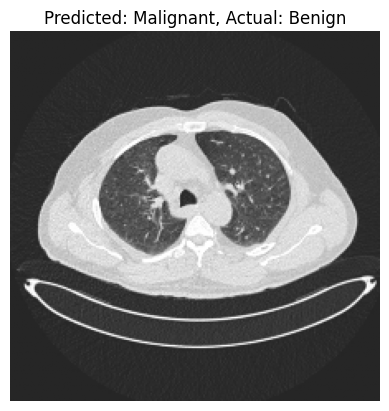

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


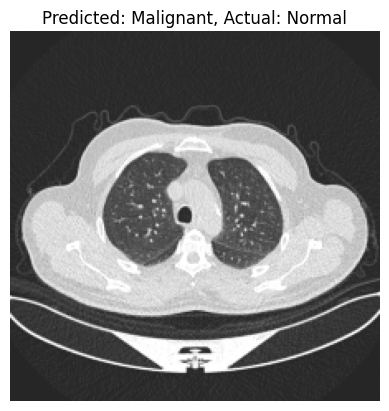

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


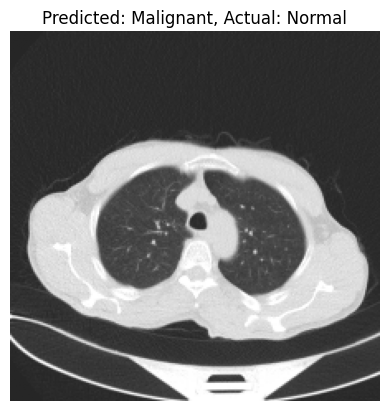

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


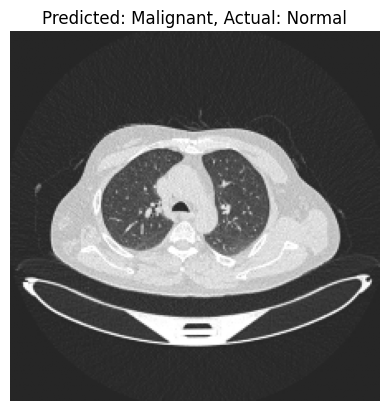

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


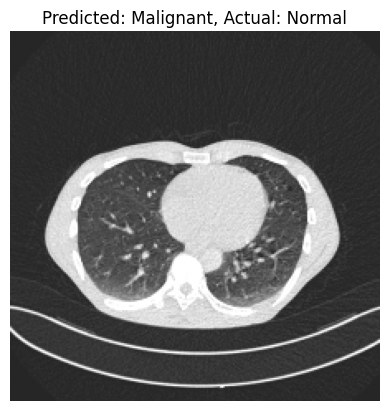

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


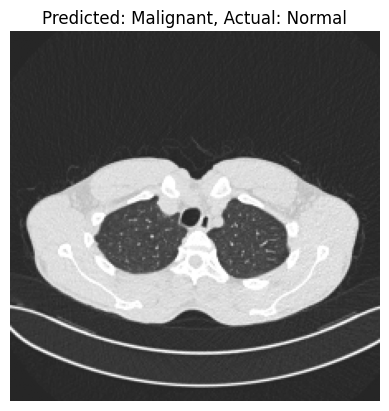

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


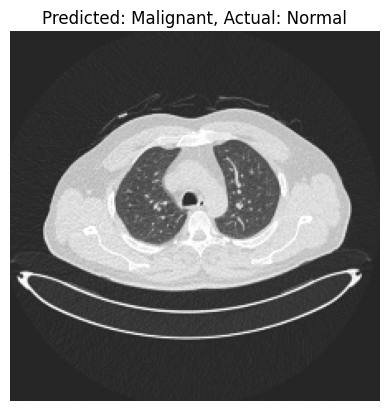

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


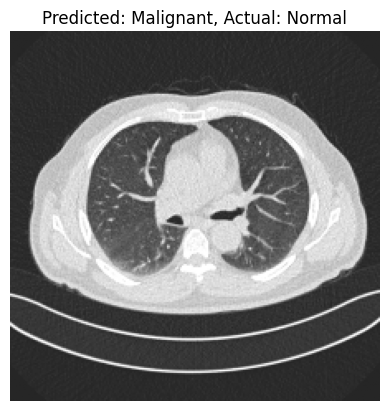

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


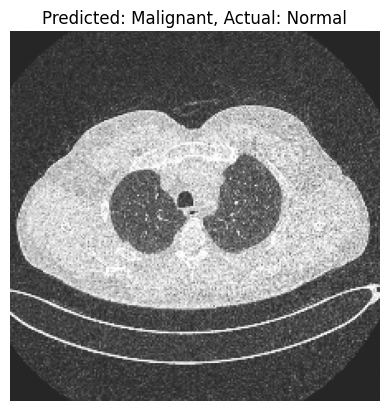

1/1 [==============================] - 0s 25ms/step
Predicted Label: Malignant, Actual Label: Normal


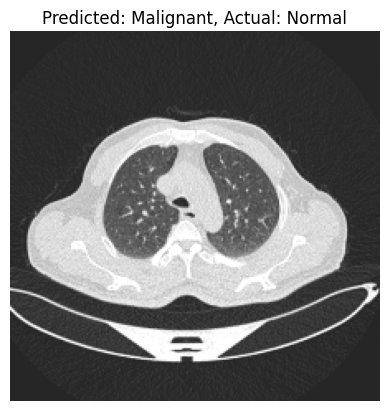

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


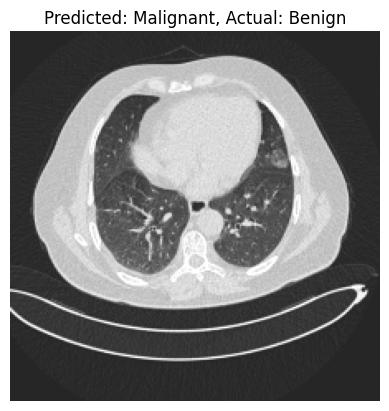

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


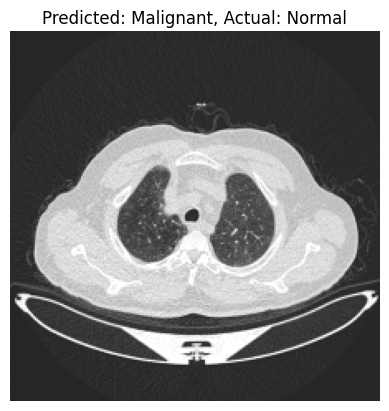

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


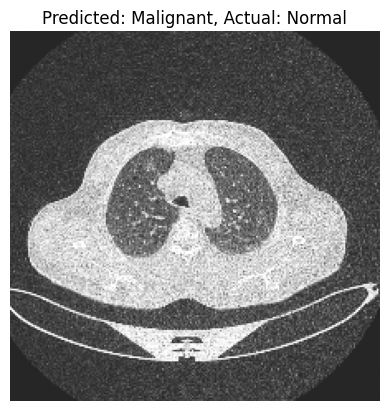

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


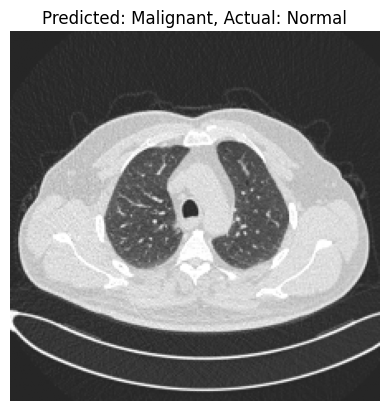

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


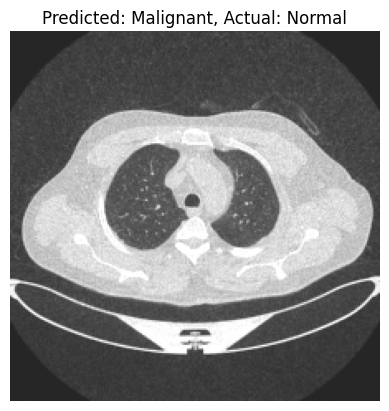

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


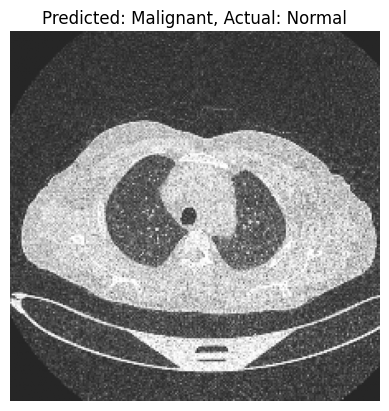

1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Normal


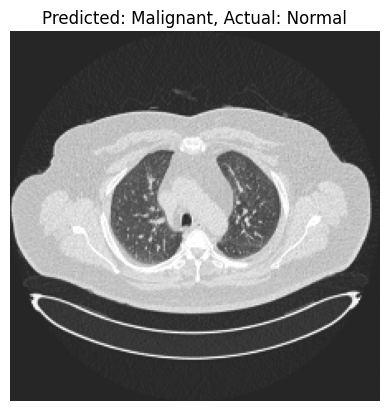

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


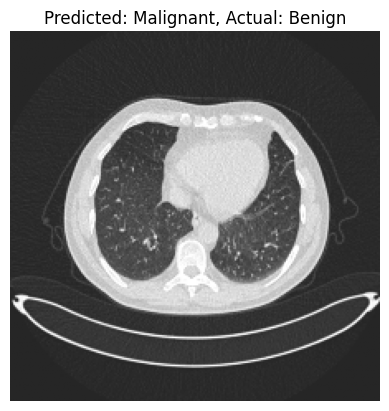

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


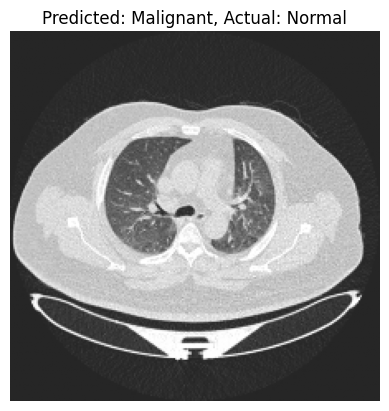

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


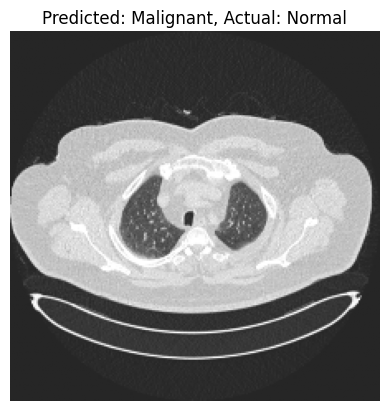

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


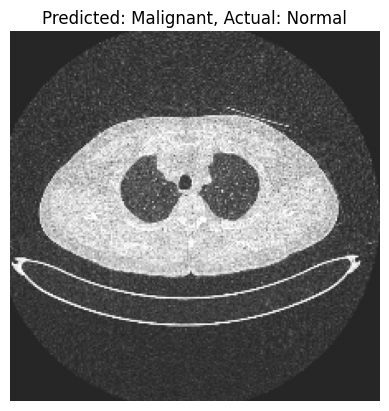

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


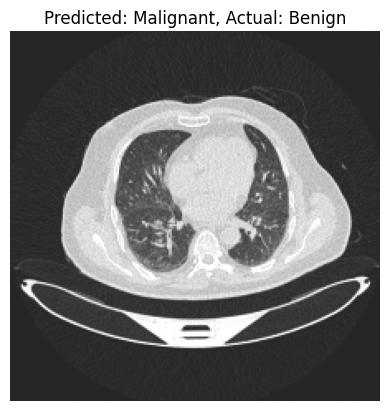

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


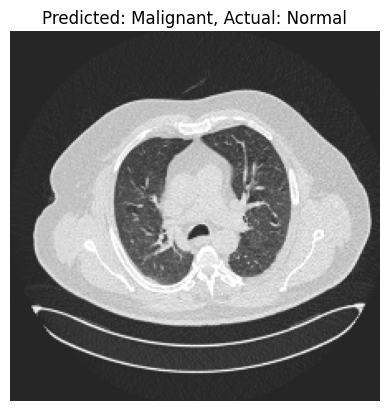

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


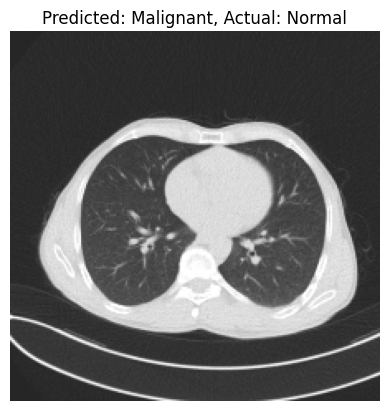

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


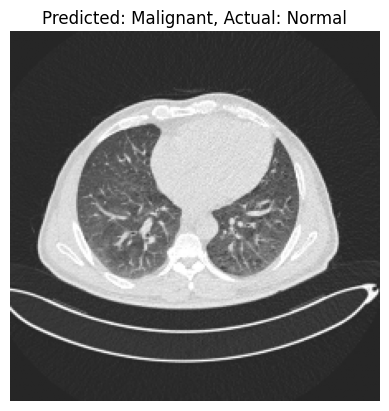

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


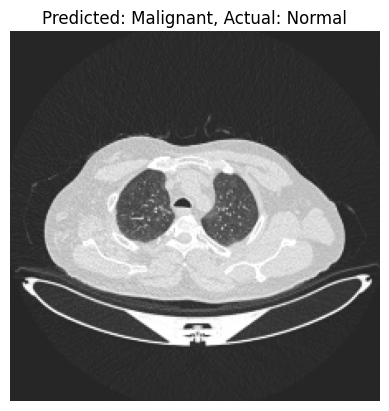

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


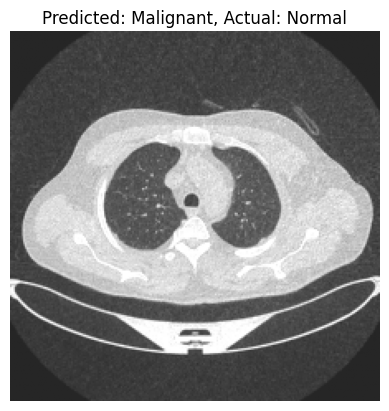

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


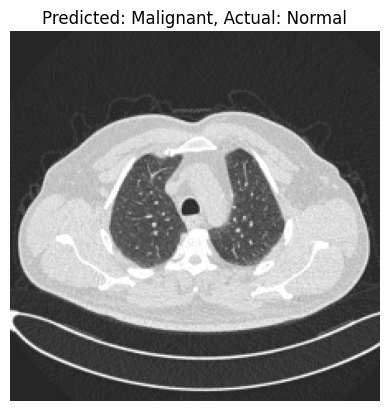

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


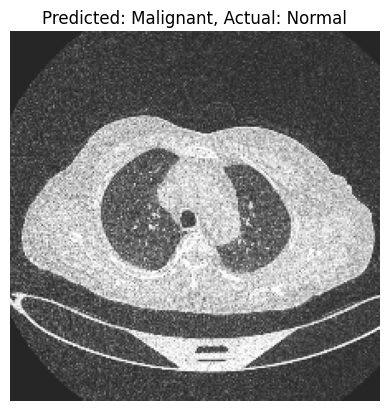

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


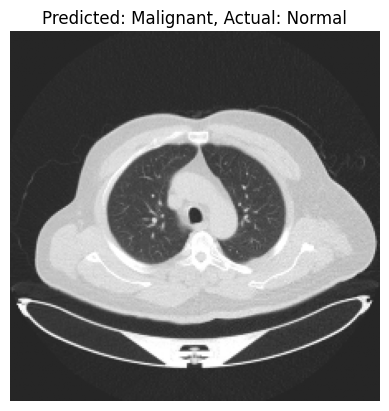

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


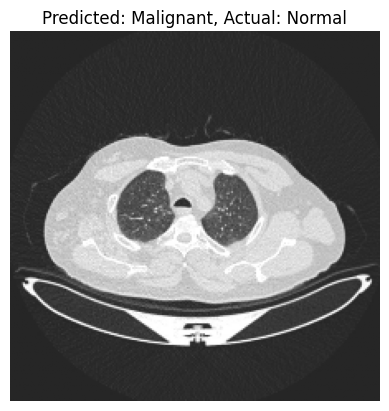

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


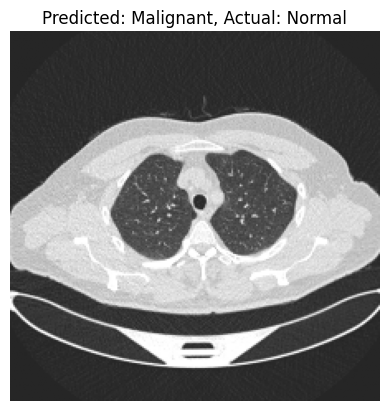

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


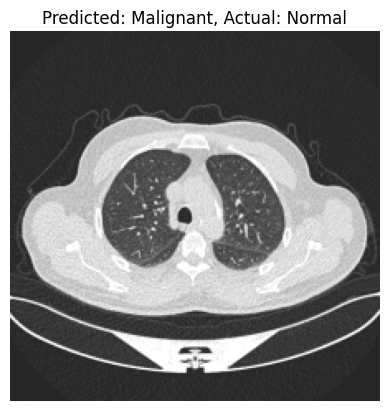

1/1 [==============================] - 0s 28ms/step
Predicted Label: Malignant, Actual Label: Normal


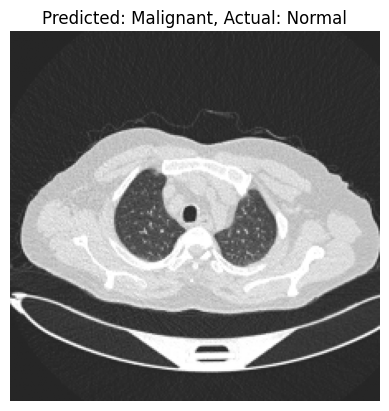

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


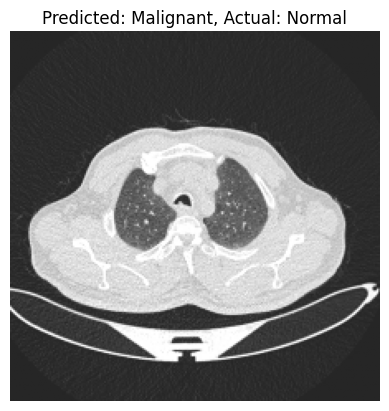

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


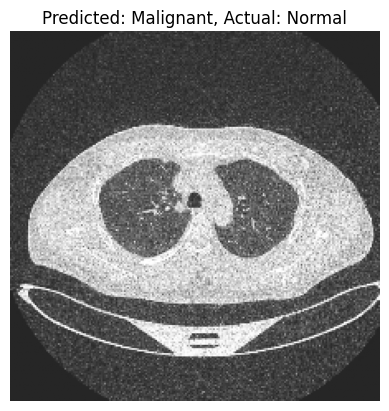

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


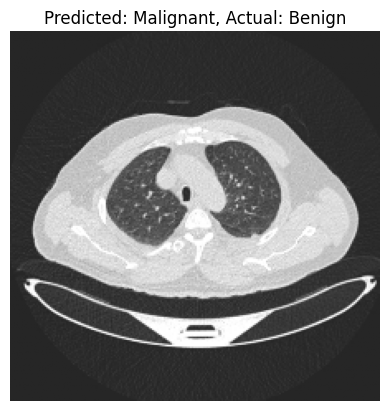

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


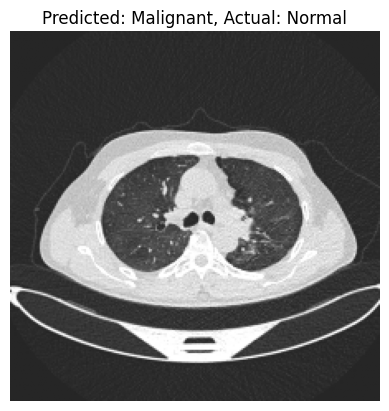

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


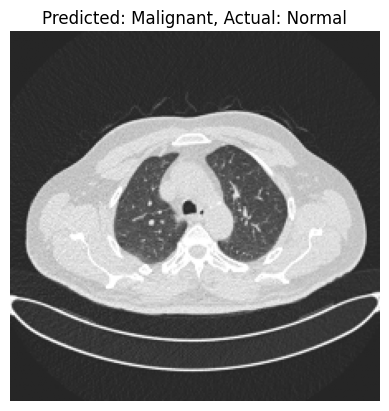

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


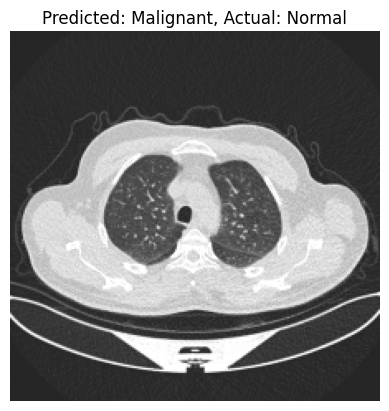

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


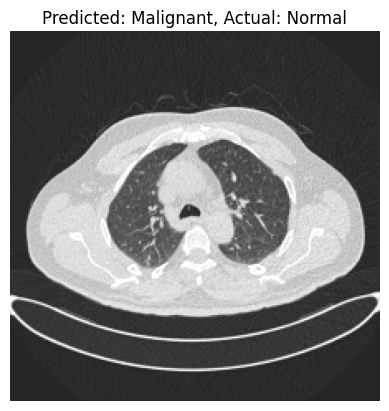

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


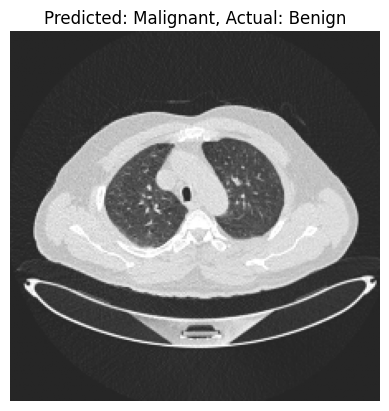

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


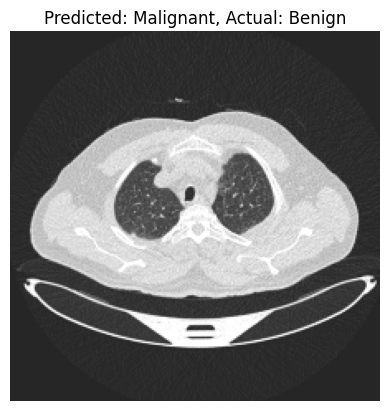

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


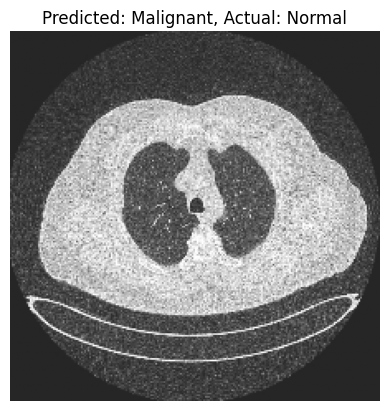

In [ ]:
# Create a function to determine predicted label vs actual label for each image with a visualization of each image

# Define the function to predict an image's label
def predict_image(image_data):
    # Reshape and preprocess image data as needed for prediction
    image_data = image_data.reshape((1, 224, 224, 3))  # Adjust the shape if necessary
    prediction = loaded_model.predict(image_data)
    predicted_class = np.argmax(prediction, axis=1)[0]
    return predicted_class

# Function to display images with their predicted and actual labels
def display_image_with_labels(image_data, pred_label, actual_label):
    plt.imshow(image_data)
    plt.title(f"Predicted: {pred_label}, Actual: {actual_label}")
    plt.axis('off')
    plt.show()

# Assuming X_val_images is already loaded and preprocessed
for i, image_data in enumerate(X_val_images):
    pred_class_index = predict_image(image_data)
    pred_label = labels[pred_class_index]  # Convert class index to class label
    actual_label_index = val.classes[i]  # Get the actual class index from validation data generator
    actual_label = labels[actual_label_index]  # Convert class index to class label

    # Check if the prediction is different from the actual label
    if pred_label != actual_label:
        # Print labels and display images
        print(f"Predicted Label: {pred_label}, Actual Label: {actual_label}")
        display_image_with_labels(image_data.reshape(224, 224, 3), pred_label, actual_label)



1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


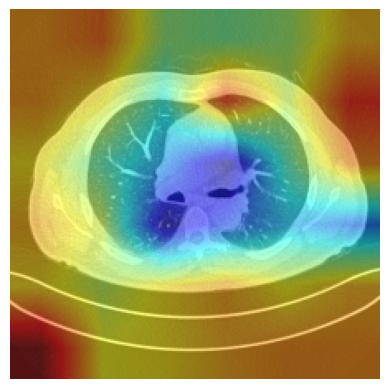

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


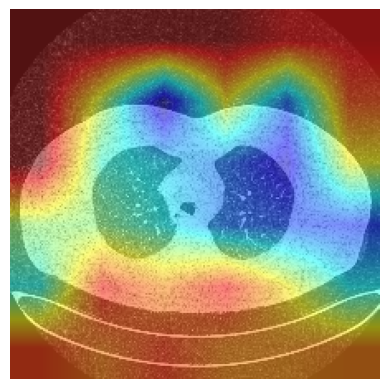

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


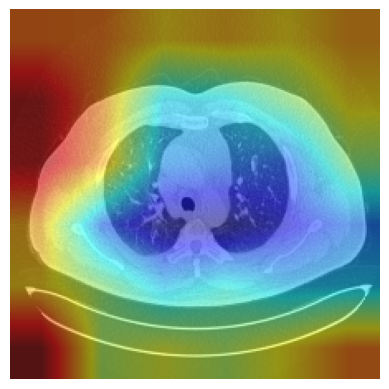

1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Normal


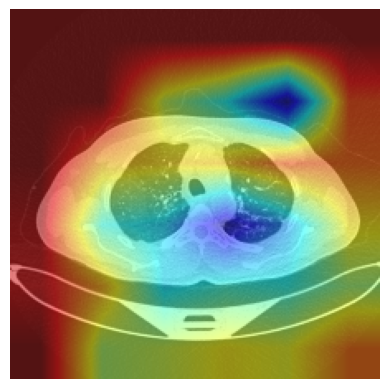

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


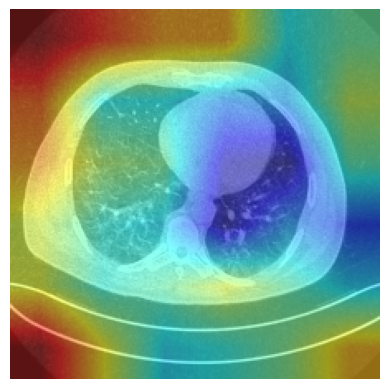

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


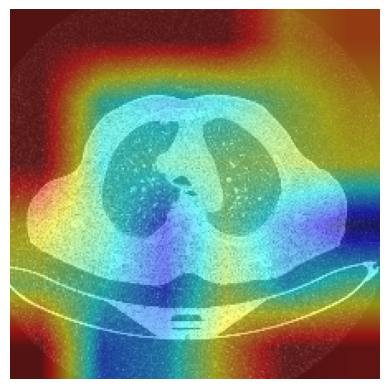

1/1 [==============================] - 0s 31ms/step
Predicted Label: Malignant, Actual Label: Normal


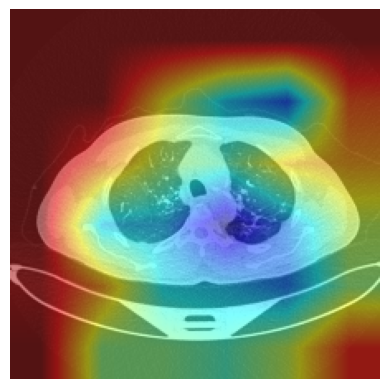

1/1 [==============================] - 0s 20ms/step
Predicted Label: Malignant, Actual Label: Normal


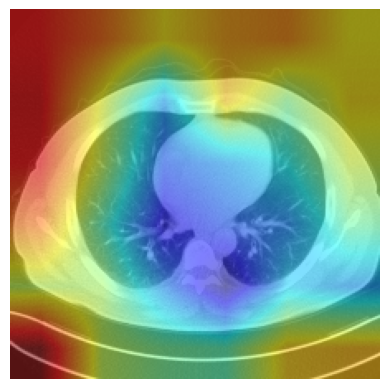

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


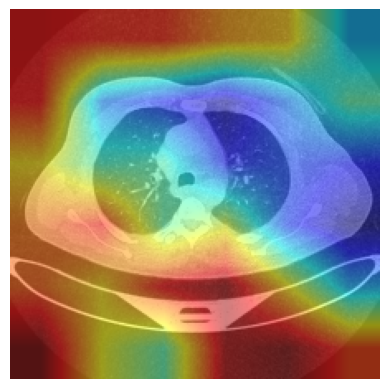

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


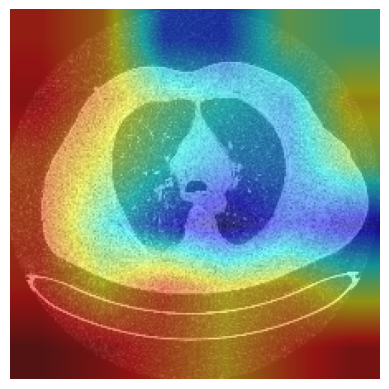

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


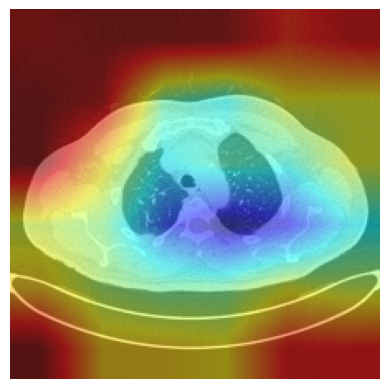

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


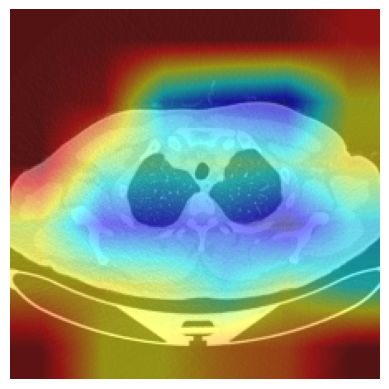

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


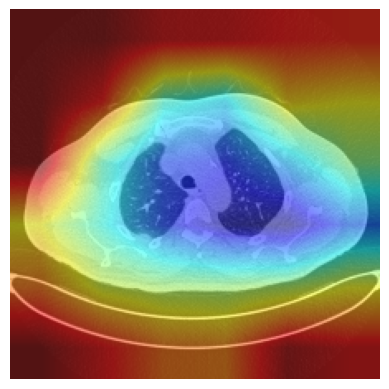

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


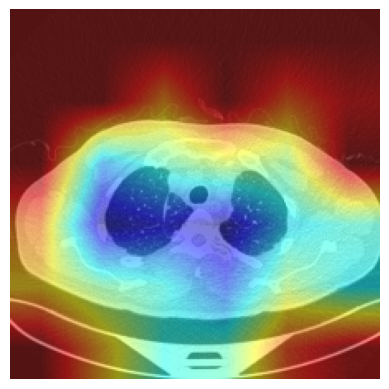

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


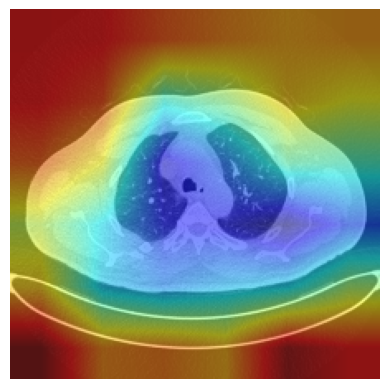

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


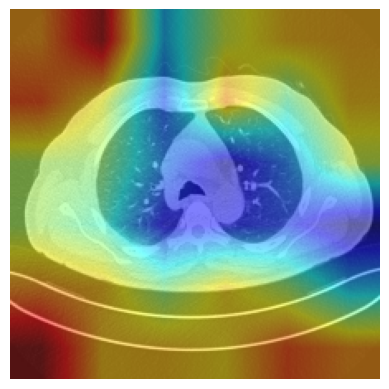

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


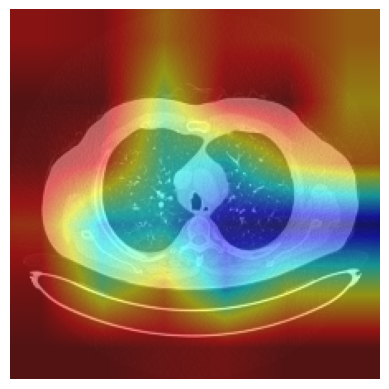

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


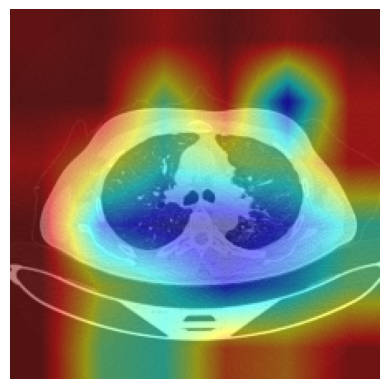

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


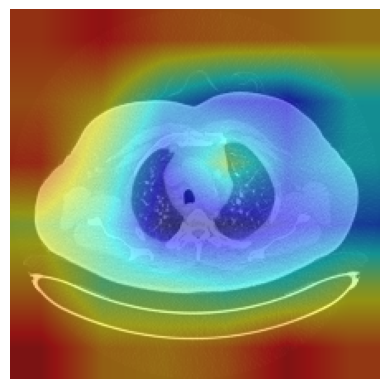

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


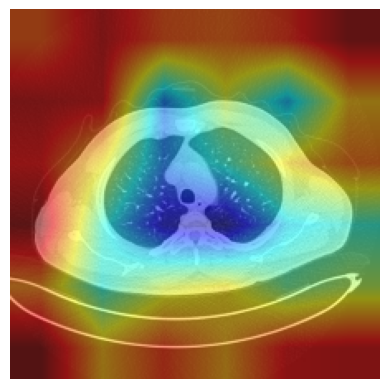

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


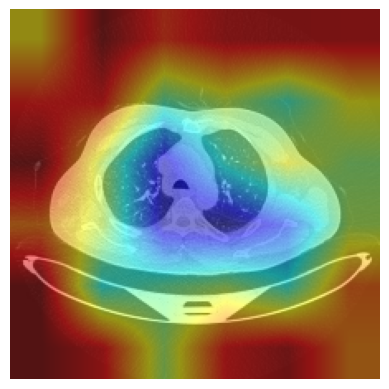

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


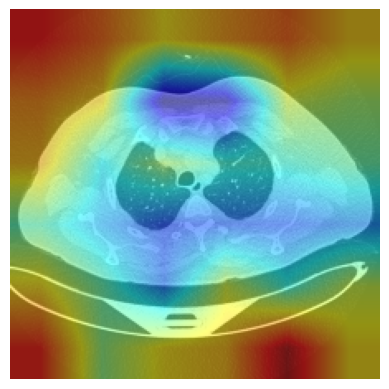

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


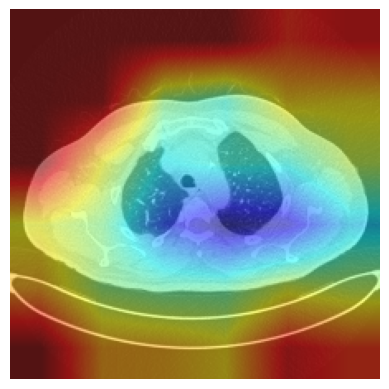

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


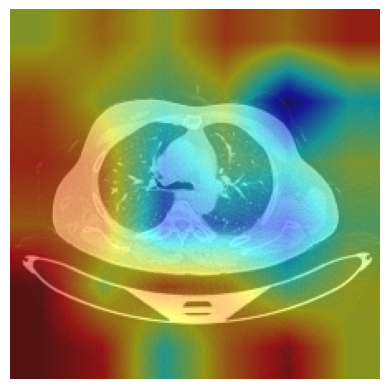

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


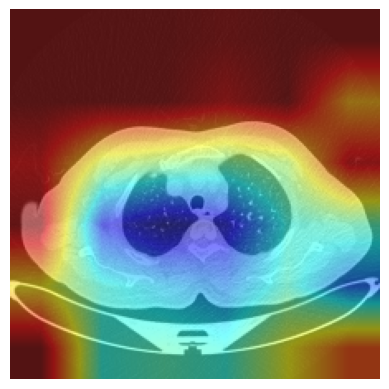

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


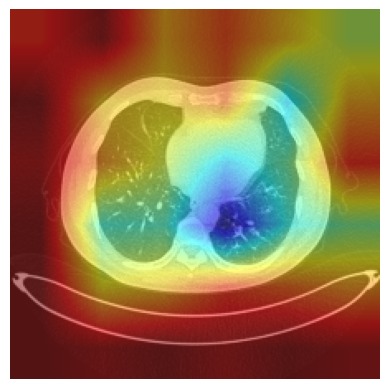

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


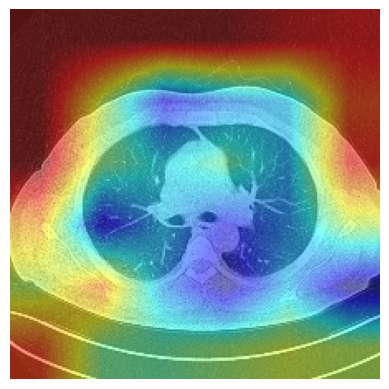

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


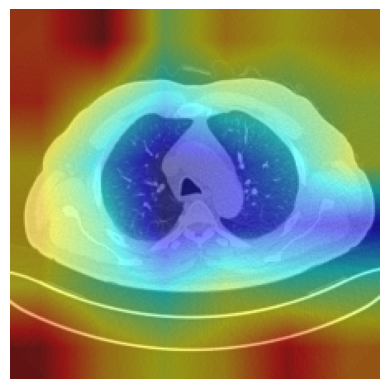

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


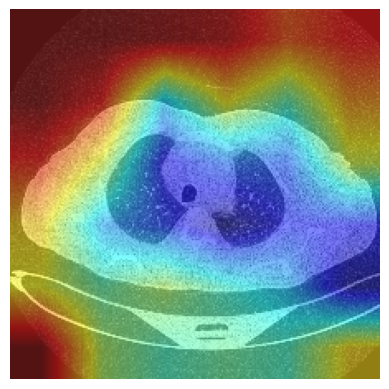

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


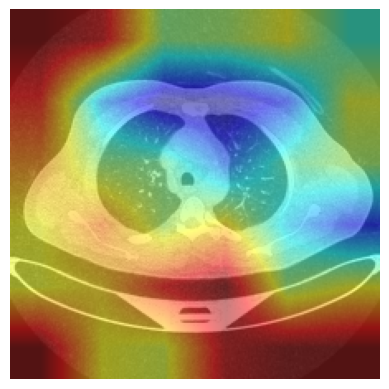

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


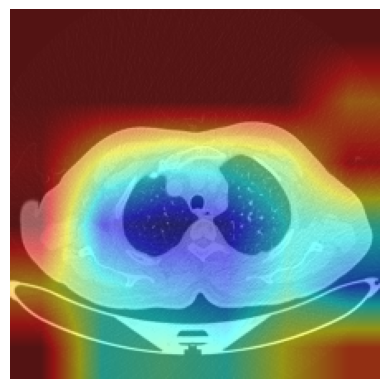

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


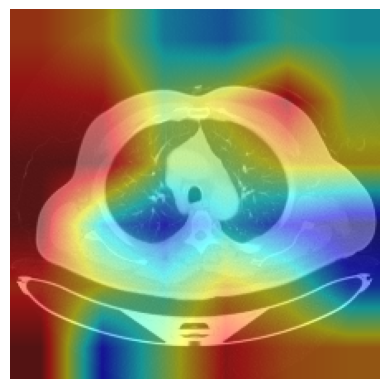

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


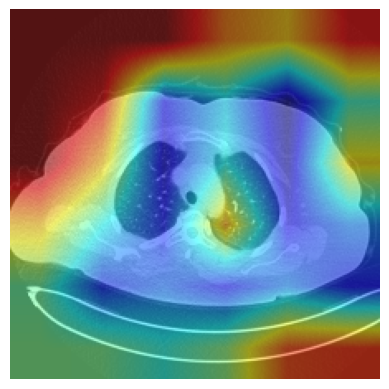

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


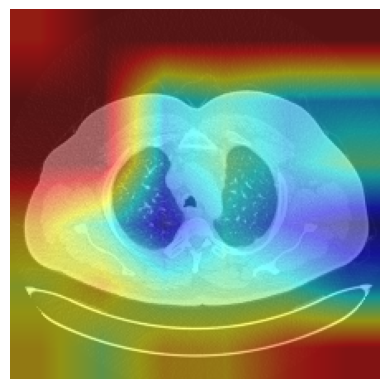

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


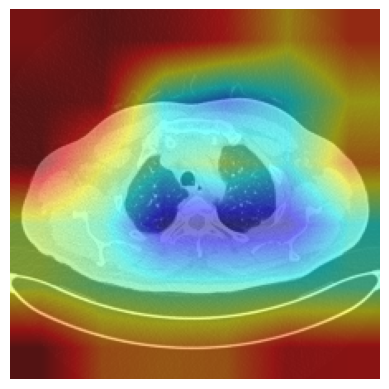

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


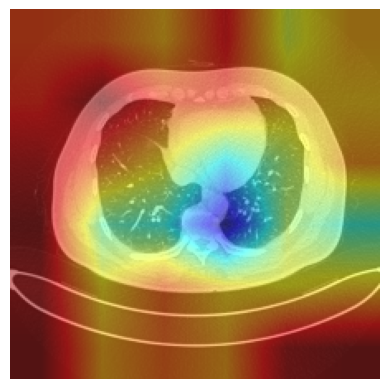

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


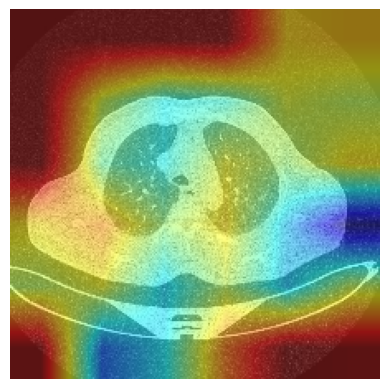

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


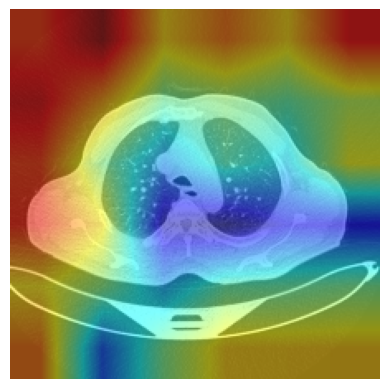

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


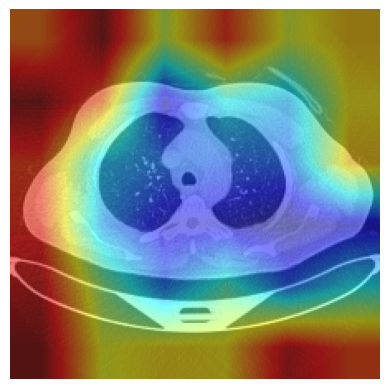

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


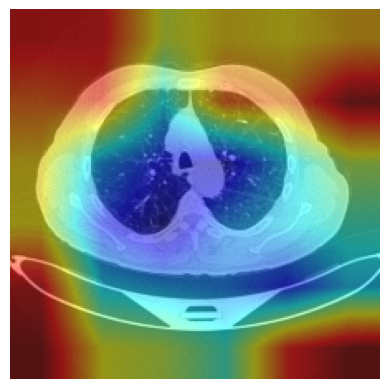

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


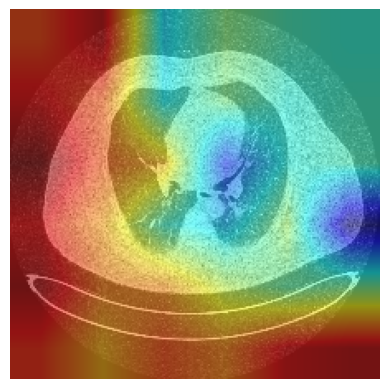

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


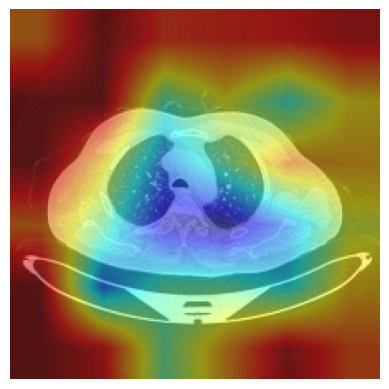

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


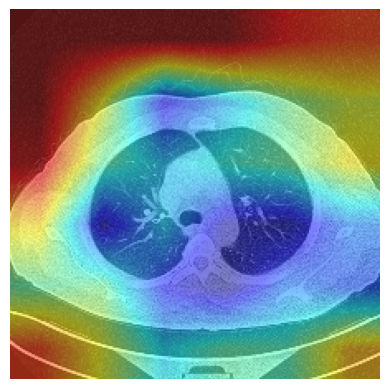

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


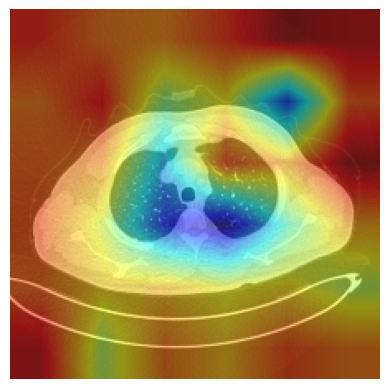

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


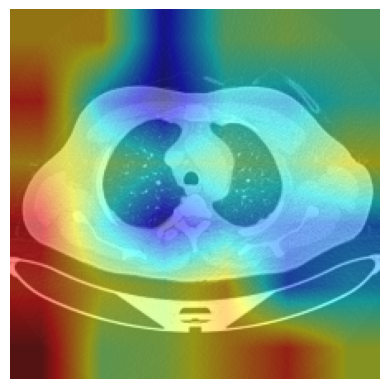

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


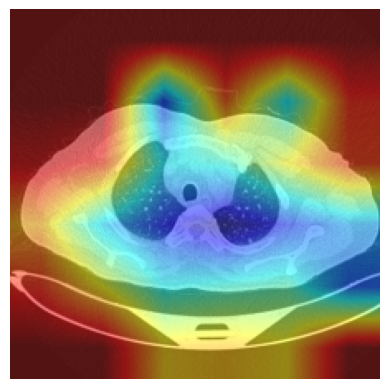

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


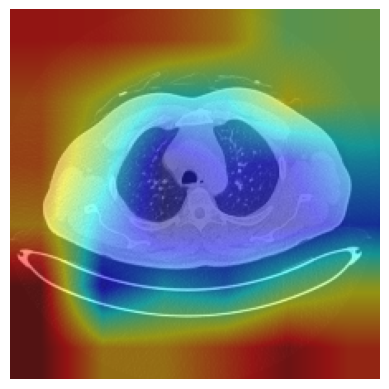

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


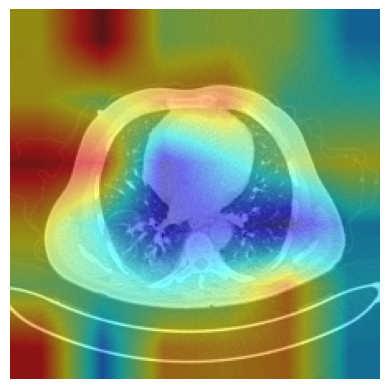

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


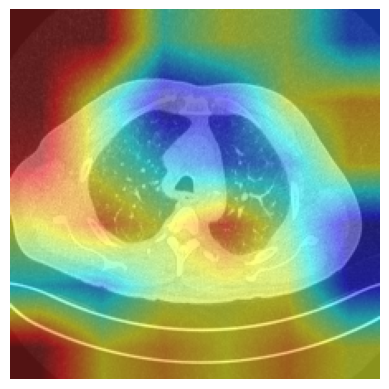

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


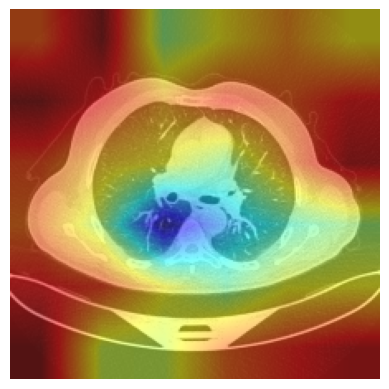

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


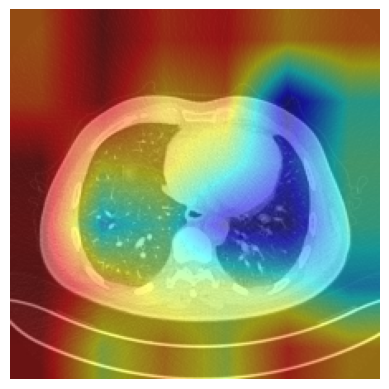

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


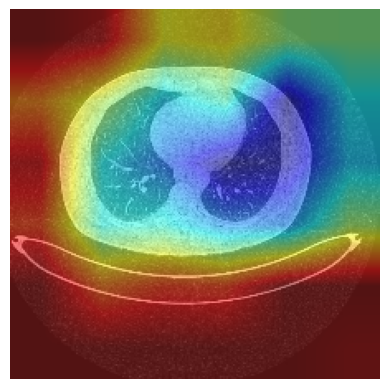

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


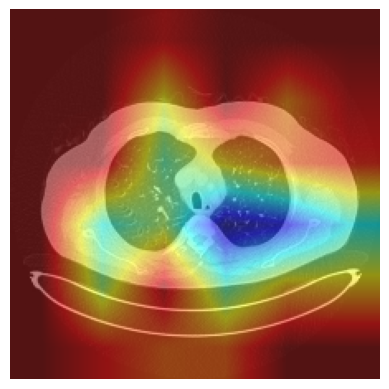

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


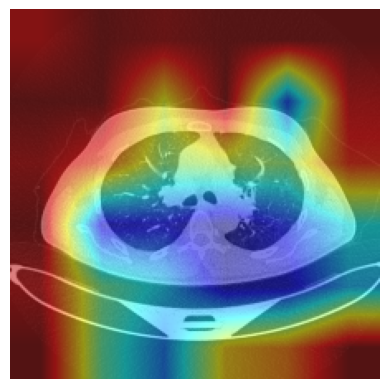

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


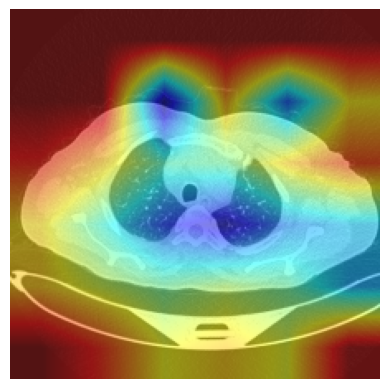

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


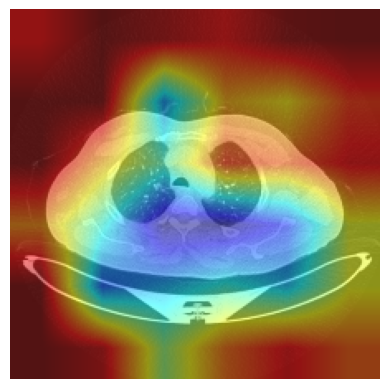

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


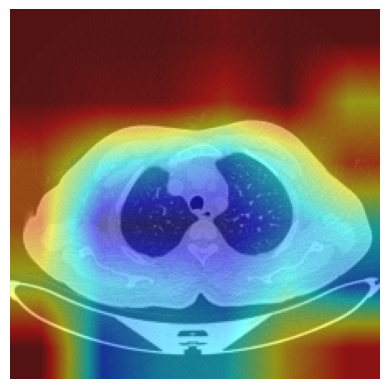

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


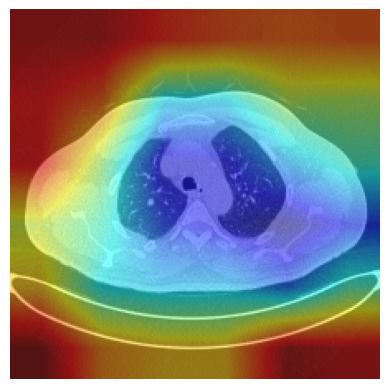

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


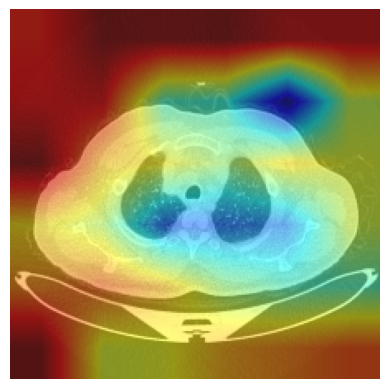

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


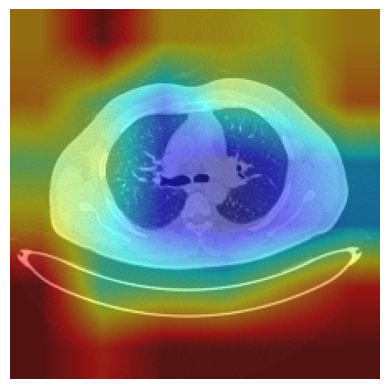

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


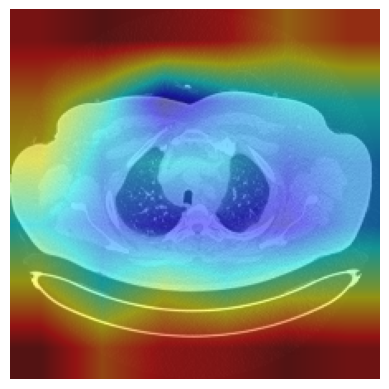

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


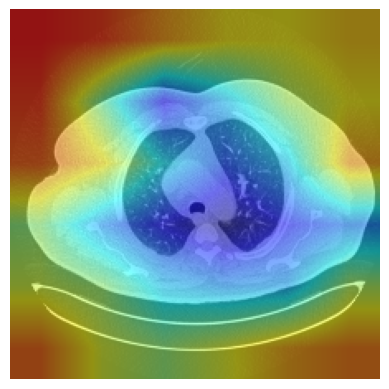

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


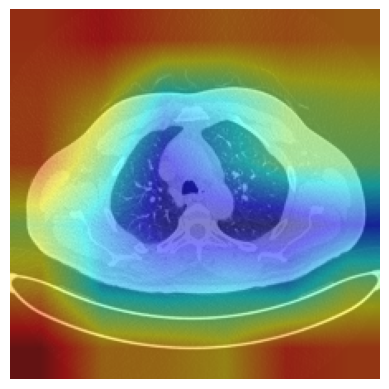

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


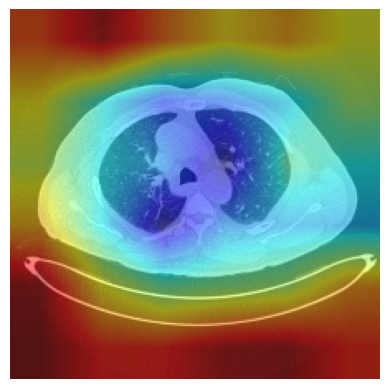

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


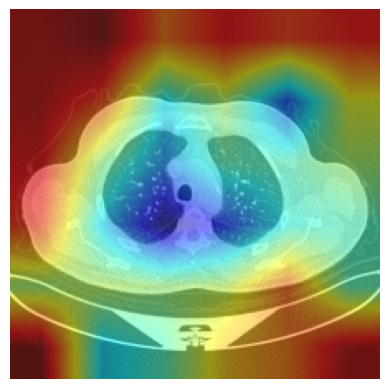

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


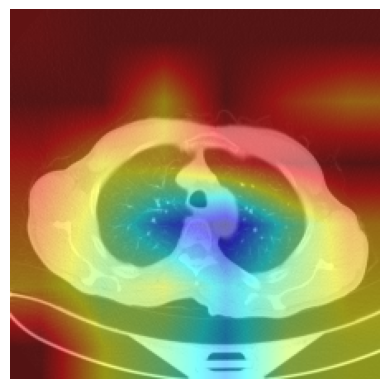

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


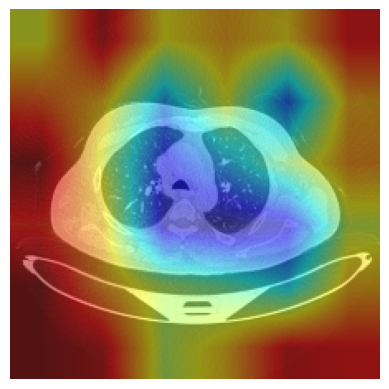

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


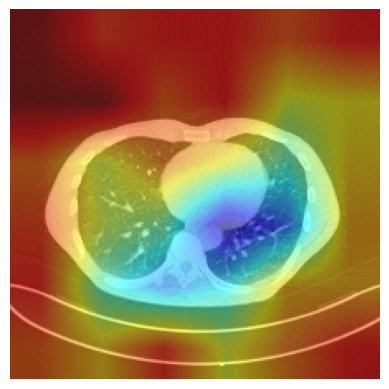

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


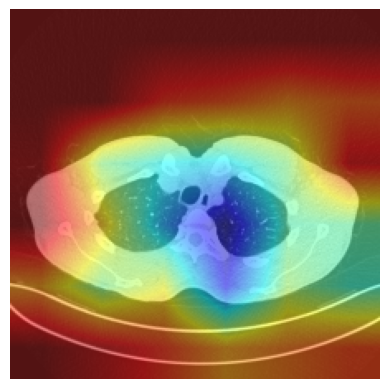

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


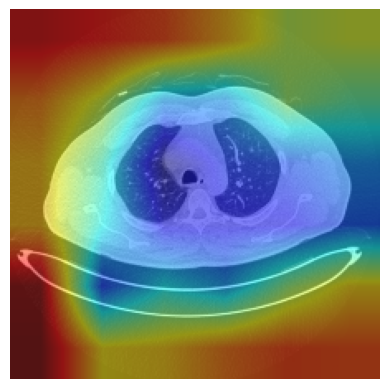

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


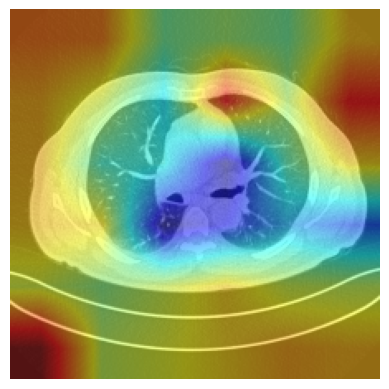

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


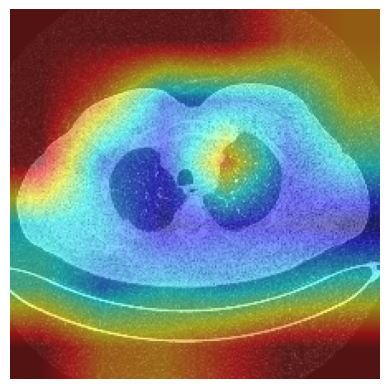

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


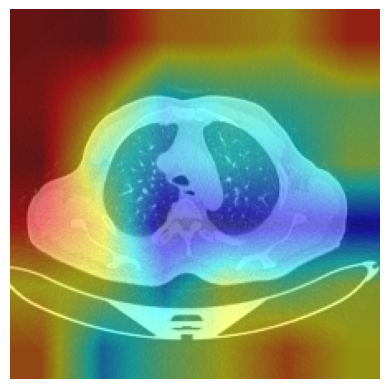

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


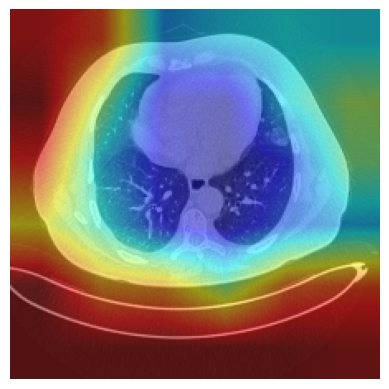

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


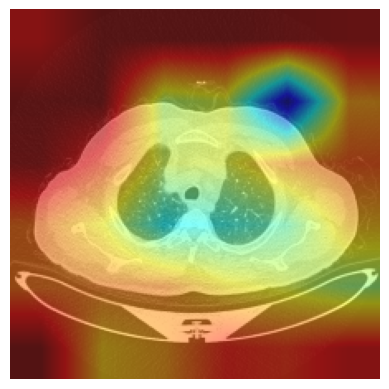

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


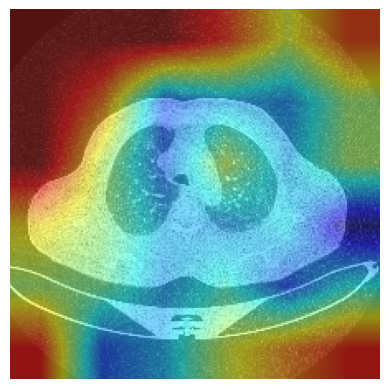

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


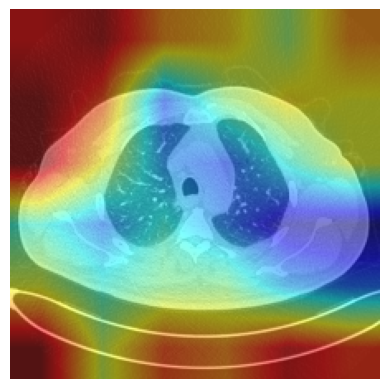

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


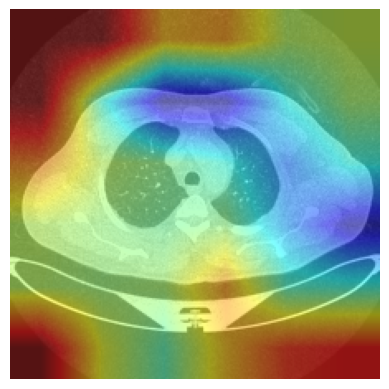

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


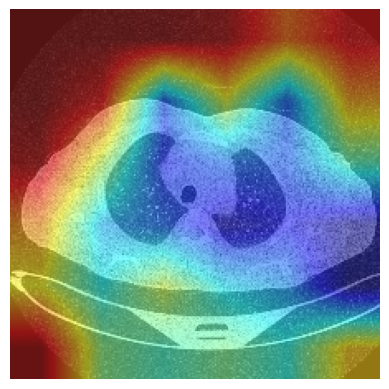

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


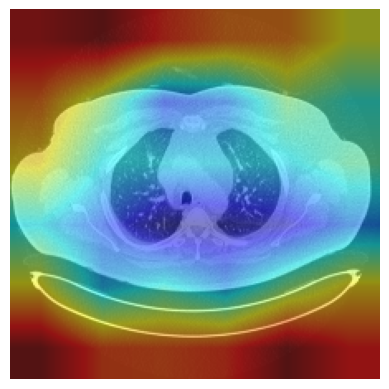

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


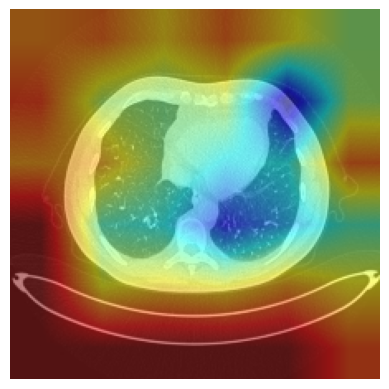

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


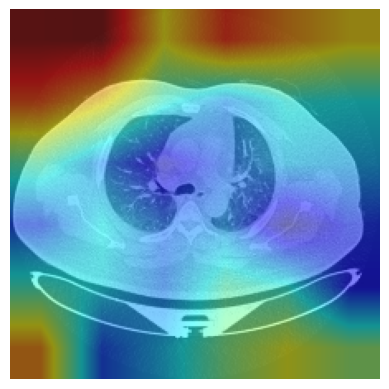

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


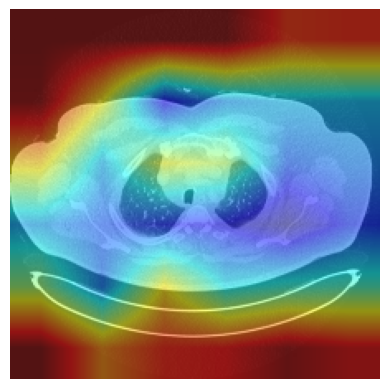

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


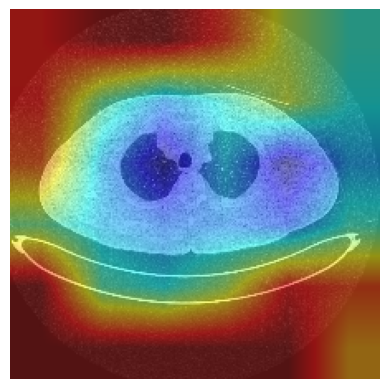

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Benign


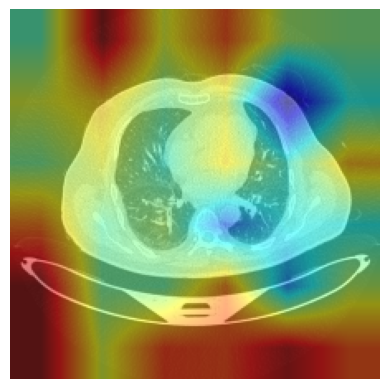

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


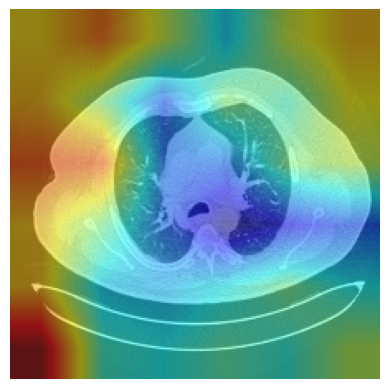

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


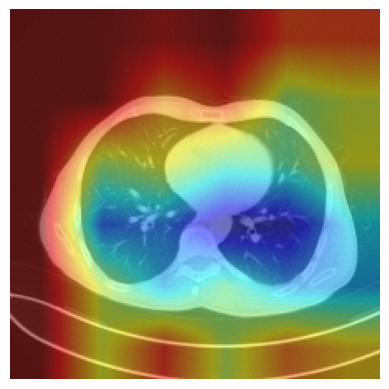

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


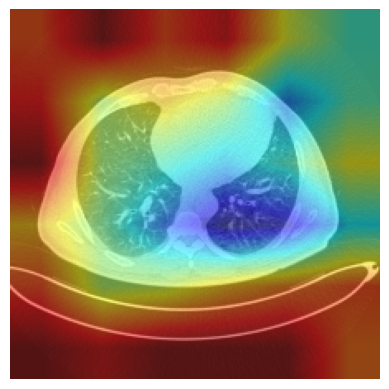

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


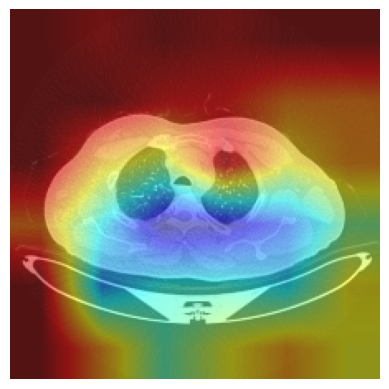

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


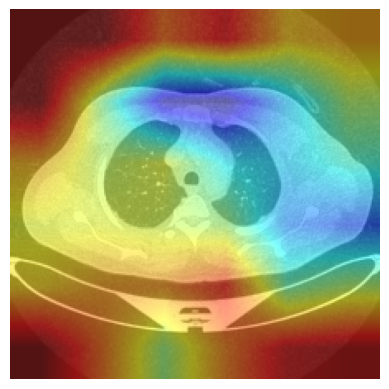

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


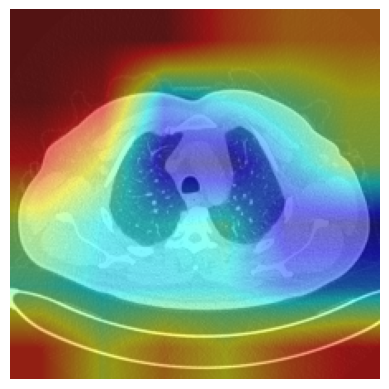

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


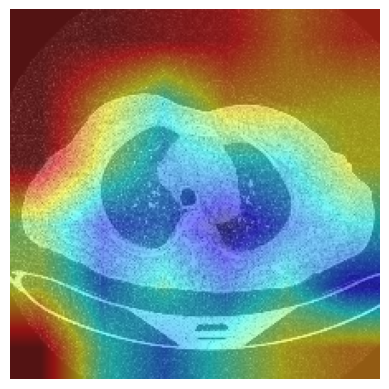

1/1 [==============================] - 0s 24ms/step
Predicted Label: Malignant, Actual Label: Normal


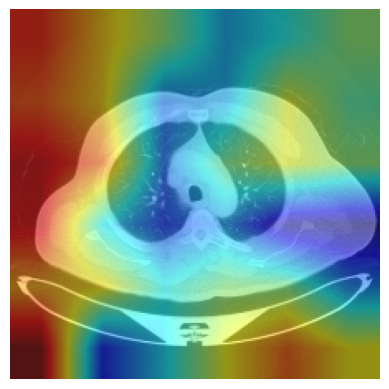

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


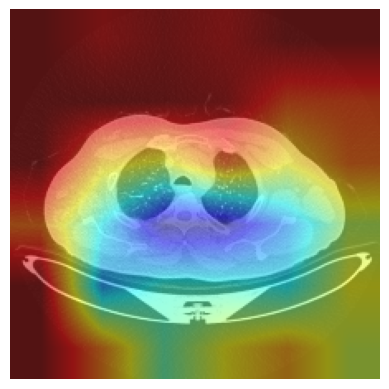

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


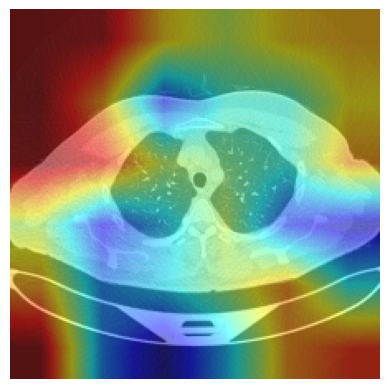

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


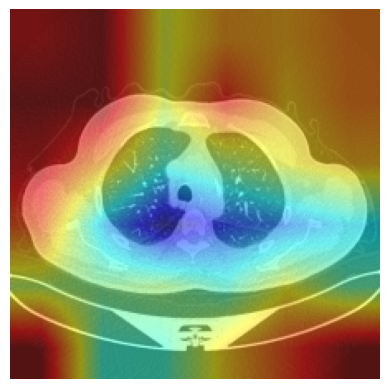

1/1 [==============================] - 0s 26ms/step
Predicted Label: Malignant, Actual Label: Normal


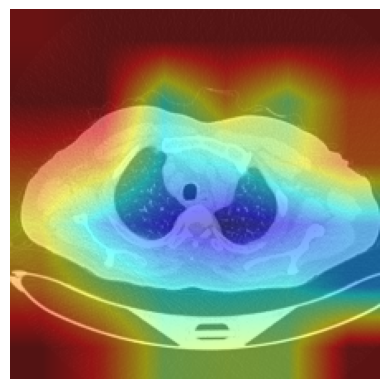

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


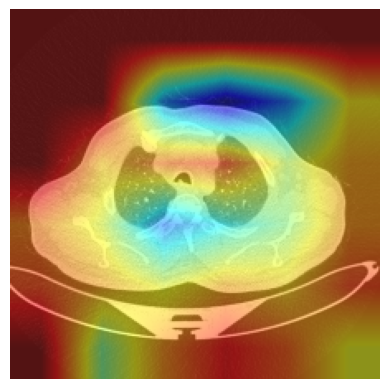

1/1 [==============================] - 0s 21ms/step
Predicted Label: Malignant, Actual Label: Normal


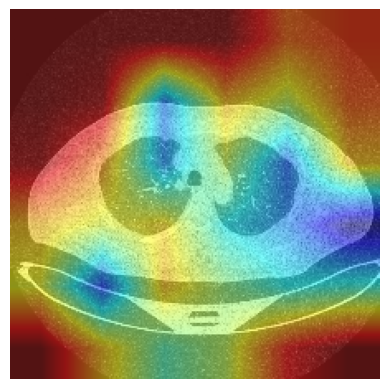

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


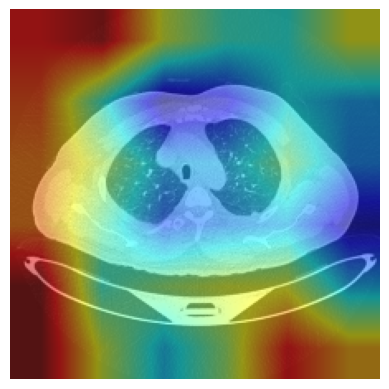

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


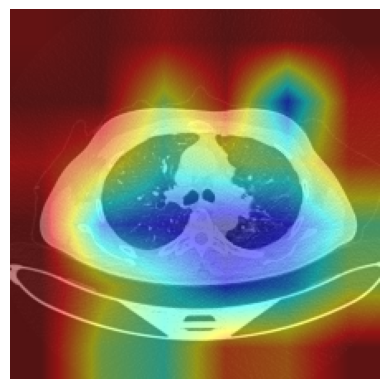

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


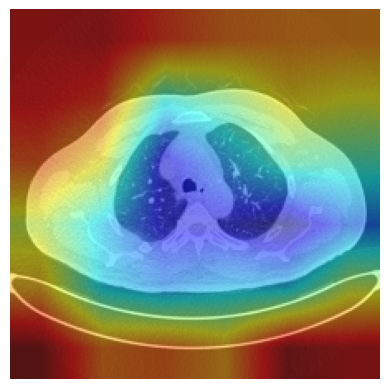

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


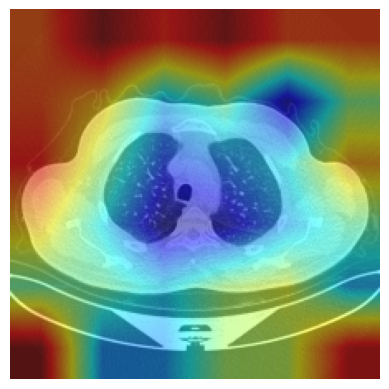

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Normal


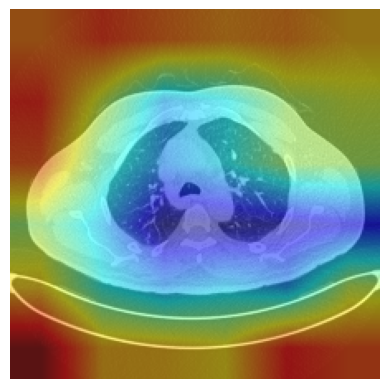

1/1 [==============================] - 0s 23ms/step
Predicted Label: Malignant, Actual Label: Benign


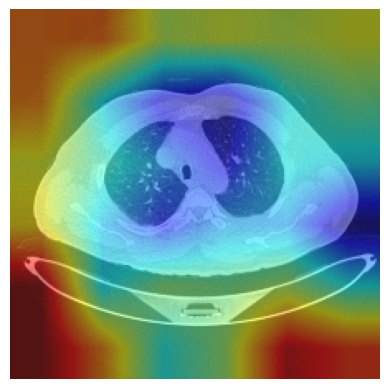

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Benign


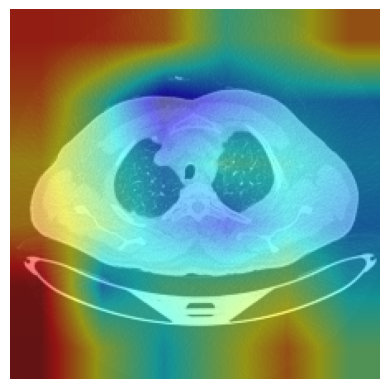

1/1 [==============================] - 0s 22ms/step
Predicted Label: Malignant, Actual Label: Normal


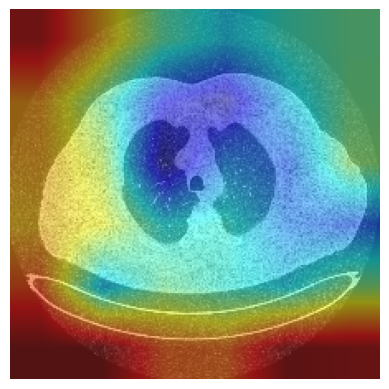

In [ ]:
# The gradient-weighted class activation map (Grad CAM) produces a heat map that highlights important regions of an image using the target gradients (dog, cat) of the final convolutional layer.
# The Grad CAM method is a popular visualisation technique that is useful for understanding how a convolutional neural network has been driven to make a classification decision. It is class-specific,
# meaning that it can produce a separate visualisation for each class present in the image. In the event of a classification error, this method can be very useful for understanding where the
# problem lies in the convolutional network. It also makes the algorithm more transparent (https://datascientest.com/en/what-is-the-grad-cam-method).

import cv2

# Function to compute Grad-CAM
def get_grad_cam(model, image, class_index, layer_name):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(layer_name).output, model.output]
    )

    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(image)
        loss = predictions[:, class_index]

    grads = tape.gradient(loss, conv_outputs)[0]
    conv_outputs = conv_outputs[0]
    weights = tf.reduce_mean(grads, axis=(0, 1))

    cam = np.zeros(conv_outputs.shape[0:2], dtype=np.float32)

    for i, w in enumerate(weights):
        cam += w * conv_outputs[:, :, i]

    cam = np.maximum(cam, 0)
    cam = cam / np.max(cam)
    cam = cv2.resize(cam, (224, 224))

    return cam

# Function to display image with Grad-CAM heatmap
def display_grad_cam(image_data, cam):
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = np.float32(heatmap) / 255
    cam_image = heatmap + np.float32(image_data)
    cam_image = cam_image / np.max(cam_image)

    plt.imshow(cam_image)
    plt.axis('off')
    plt.show()

# Assuming X_val_images is already loaded and preprocessed
layer_name = 'conv2d_8'  # Replace with the name of the last conv layer in your model
for i, image_data in enumerate(X_val_images):
    pred_class_index = predict_image(image_data)
    pred_label = labels[pred_class_index]  # Convert class index to class label
    actual_label_index = val.classes[i]  # Get the actual class index from validation data generator
    actual_label = labels[actual_label_index]  # Convert class index to class label

    if pred_label != actual_label:
        # Print labels and display images
        print(f"Predicted Label: {pred_label}, Actual Label: {actual_label}")

        # Compute Grad-CAM heatmap
        image_input = image_data.reshape((1, 224, 224, 3))  # Adjust shape if necessary
        cam = get_grad_cam(loaded_model, image_input, pred_class_index, layer_name)

        # Display image with Grad-CAM heatmap
        display_grad_cam(image_data.reshape(224, 224, 3), cam)



In [ ]:
pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 9.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=87dae2b2adea887a9f6b28df9d280329e84744528da3e838be5b47245ced8d2e
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


  0%|          | 0/1000 [00:00<?, ?it/s]

1/1 [==============================] - 0s 26ms/step


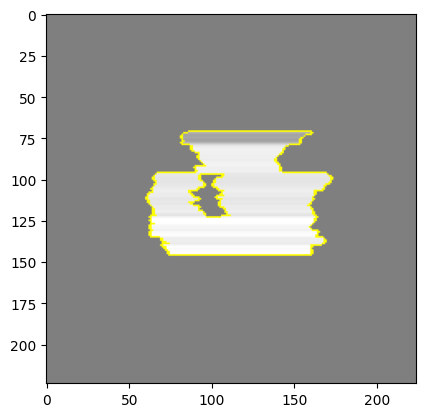

In [ ]:
# LIME is a model-agnostic machine learning tool that helps you interpret your ML models. The term model-agnostic means that you can use LIME with any machine learning model when training your
# data and interpreting the results. LIME uses "inherently interpretable models" such as decision trees, linear models, and rule-based heuristic models to explain results to non-technical
# users with visual forms. You can use LIME for regression and classification problems to interpret your black box models (https://www.freecodecamp.org/news/interpret-black-box-model-using-lime/,
# https://github.com/marcotcr/lime/blob/master/doc/notebooks/Tutorial%20-%20Image%20Classification%20Keras.ipynb).

from lime import lime_image
from skimage.segmentation import mark_boundaries

# Define a function to predict using the loaded model
def model_predict(images):
    return loaded_model.predict(images)

# Initialize the LimeImageExplainer
explainer = lime_image.LimeImageExplainer()

# Retrieve and reshape the image
image = X_val_images[image_index]

# Convert grayscale to RGB using NumPy
image_rgb = np.stack((image,) * 3, axis=-1)

# Ensure the shape is (224, 224, 3) by resizing or adjusting as necessary
image_rgb_resized = cv2.resize(image_rgb, (224, 224))

# Function to display explanations
def display_explanation(image, explanation):
    #temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, hide_rest=False)
    temp, mask = explanation.get_image_and_mask(explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=True)
    plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))

# Select an image for explanation
image_index = 0
explanation = explainer.explain_instance(image_rgb_resized, model_predict, top_labels=5, hide_color=0, num_samples=1000)
#explanation = explainer.explain_instance(image_rgb_resized, model_predict, top_labels=1, num_samples=1000)
display_explanation(X_val_images[image_index], explanation)


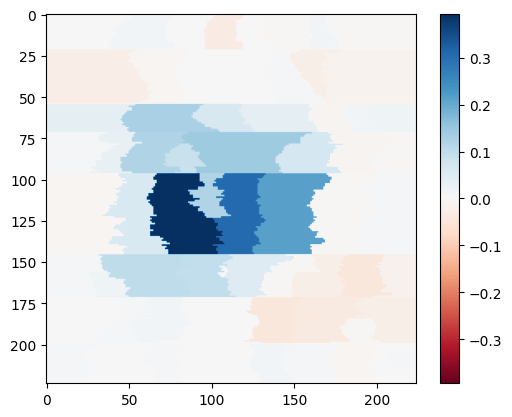

In [ ]:
# Create a heatmap using LIME of the pixels with the highest explanation for predicting the classifier (blue means highest explanation, red means least explanation)

# Select the same class explained on the figures above.
ind =  explanation.top_labels[0]

# Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanation.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation.segments)

# Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()